##### Steps for reading in dataset (following download), initial QC, dim reduction/clustering and saving out the myeloid cluster for **GSE180661**

This dataset contains 158 samples from 41 pre-treatment OC patients
Sites: 
* adnexa (ovary and fallopian tube) - primary
* omentum
* peritoneum
* bowel
* ascites
* other intra-peritonel sites

Kelvin downloaded data for me (rds objects), due to the size likely too large to merge. May need to export myeloid cells first and then merge

The data kelvin downloaded is one rds (seurat) object per patient (this includes multiple matched sites per patient)




In [1]:
#set wd
getwd()
setwd('/scratch/user/s4436039/scdata/GSE180661')
getwd()

[1] "/scratch/user/s4436039/Nikita-project"

[1] "/scratch/user/s4436039/scdata/GSE180661"

In [2]:
#Load packages
library(dplyr)
library(Seurat)
library(patchwork)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following object is masked from ‘package:base’:

    intersect




In [3]:
P002 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-002.rds")
P003 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-003.rds")
P007 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-007.rds")
P008 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-008.rds")
P009 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-009.rds")
P014 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-014.rds")
P022 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-022.rds")
P024 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-024.rds")
P025 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-025.rds")
P026 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-026.rds")
P031 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-031.rds")
P036 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-036.rds")
P037 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-037.rds")
P041 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-041.rds")
P042 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-042.rds")
P045 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-045.rds")
P049 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-049.rds")
P050 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-050.rds")
P051 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-051.rds")
P052 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-052.rds")
P053 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-053.rds")
P054 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-054.rds")
P065 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-065.rds")
P067 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-067.rds")
P068 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-068.rds")
P070 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-070.rds")
P071 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-071.rds")
P075 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-075.rds")
P077 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-077.rds")
P080 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-080.rds")
P081 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-081.rds")
P082 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-082.rds")
P083 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-083.rds")
P090 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-090.rds")
P105 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-105.rds")
P107 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-107.rds")
P110 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-110.rds")
P112 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-112.rds")
P115 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-115.rds")
P116 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-116.rds")
P118 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/SPECTRUM-OV-118.rds")

In [4]:
head(P002@meta.data)
tail(P002@meta.data)

,sample,cell_type,percent.mt,nCount_RNA,nFeature_RNA,umap50_1,umap50_2,cluster_label,cluster_label_sub,cell_type_super,patient_id,tumor_subsite,tumor_site,tumor_supersite,sort_parameters,therapy,surgery
,<fct>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCAAGTCTAACC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,6.528371,8195,2691,-8.679758,6.763180,CD8.T.cytotoxic,CD8.T.effector.memory,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1
SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCACAAACTCGT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.581297,5197,1791,-10.031369,5.792929,CD8.T.ISG,CD4.T.ISG,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1
SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCAGTGAATTGA,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.552810,5018,1727,-9.832402,7.440627,CD4.T.naive,CD4.T.effector.memory,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1
SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAAAGGACACTG,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.004060,6896,2263,-9.703304,4.135003,CD4.T.reg,CD4.T.reg.1,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1
SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAACATCTCAAG,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,9.461397,4883,1798,-7.801433,6.679767,NA,NA,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1
SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAAGTATGAAGT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,12.360910,4134,1325,-8.263696,8.116325,NA,NA,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1


,sample,cell_type,percent.mt,nCount_RNA,nFeature_RNA,umap50_1,umap50_2,cluster_label,cluster_label_sub,cell_type_super,patient_id,tumor_subsite,tumor_site,tumor_supersite,sort_parameters,therapy,surgery
,<fct>,<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>
SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY_TTTGGTTTCCACTTTA,SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY,T.cell,10.674886,6164,2391,-11.127443,2.245321,CD4.T.reg,CD4.T.reg.2,T.super,SPECTRUM-OV-002,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1
SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY_TTTGGTTTCGGATAAA,SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY,T.cell,7.854985,7282,2461,-6.028986,3.109145,CD8.T.ISG,CD8.T.dysfunc.ISG,T.super,SPECTRUM-OV-002,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1
SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY_TTTGTTGAGTCTAGCT,SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY,T.cell,8.684965,4882,1560,-6.491462,2.758544,NA,NA,T.super,SPECTRUM-OV-002,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1
SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY_TTTGTTGCATATGGCT,SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY,Myeloid.cell,5.025006,20995,3788,-2.397530,-9.490385,NA,NA,Myeloid.super,SPECTRUM-OV-002,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1
SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY_TTTGTTGTCTAGTCAG,SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY,T.cell,7.265210,8465,3050,-5.097231,8.715179,CD4.Th17,CD4.Th17.3,T.super,SPECTRUM-OV-002,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1
SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY_TTTGTTGTCTCTCTAA,SPECTRUM-OV-002_S1_CD45P_RIGHT_OVARY,B.cell,8.199913,4622,1720,-3.110920,15.263931,B.Mature,NA,B.super,SPECTRUM-OV-002,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1


In [5]:
table(P002$tumor_site)
table(P002$tumor_subsite)
table(P002$tumor_supersite)


     Omentum Right Adnexa 
        2763         4950 


Infracolic Omentum        Right Ovary 
              2763               4950 


 Adnexa Omentum 
   4950    2763 

In [6]:
table(P116$tumor_site)
table(P116$tumor_subsite)
table(P116$tumor_supersite)


     Ascites      Omentum        Other Right Adnexa 
        7212         8022         8012         5948 


               Ascites     Infracolic Omentum           Right Adnexa 
                  7212                   8022                   5948 
Right Paracolic Gutter 
                  8012 


 Adnexa Ascites Omentum   Other 
   5948    7212    8022    8012 

From above tumor_supersite is what I'll use to distinguish sites --> set sample_type to this to match convention with other datasets. Note anything that says adnexa can be considered primary and everything else is mets

All samples are HGSOC so can set cancer_type to that

sample_id needs to be unique to each sample, set to what is currently sample

patient_id is already there

add GSE180661_HGSOC to start of all barcodes

In [7]:
P002@meta.data$sample_type <- P002@meta.data$tumor_supersite
P002@meta.data$cancer_type <- "HGSOC"
P002@meta.data$sample_id <- P002@meta.data$sample
colnames(P002) <- paste0("GSE180661_HGSOC_", colnames(P002))

In [8]:
P003@meta.data$sample_type <- P003@meta.data$tumor_supersite
P003@meta.data$cancer_type <- "HGSOC"
P003@meta.data$sample_id <- P003@meta.data$sample
colnames(P003) <- paste0("GSE180661_HGSOC_", colnames(P003))

In [9]:
P007@meta.data$sample_type <- P007@meta.data$tumor_supersite
P007@meta.data$cancer_type <- "HGSOC"
P007@meta.data$sample_id <- P007@meta.data$sample
colnames(P007) <- paste0("GSE180661_HGSOC_", colnames(P007))

In [10]:
P008@meta.data$sample_type <- P008@meta.data$tumor_supersite
P008@meta.data$cancer_type <- "HGSOC"
P008@meta.data$sample_id <- P008@meta.data$sample
colnames(P008) <- paste0("GSE180661_HGSOC_", colnames(P008))

In [11]:
P009@meta.data$sample_type <- P009@meta.data$tumor_supersite
P009@meta.data$cancer_type <- "HGSOC"
P009@meta.data$sample_id <- P009@meta.data$sample
colnames(P009) <- paste0("GSE180661_HGSOC_", colnames(P009))

In [12]:
P014@meta.data$sample_type <- P014@meta.data$tumor_supersite
P014@meta.data$cancer_type <- "HGSOC"
P014@meta.data$sample_id <- P014@meta.data$sample
colnames(P014) <- paste0("GSE180661_HGSOC_", colnames(P014))

In [13]:
P022@meta.data$sample_type <- P022@meta.data$tumor_supersite
P022@meta.data$cancer_type <- "HGSOC"
P022@meta.data$sample_id <- P022@meta.data$sample
colnames(P022) <- paste0("GSE180661_HGSOC_", colnames(P022))

In [14]:
P024@meta.data$sample_type <- P024@meta.data$tumor_supersite
P024@meta.data$cancer_type <- "HGSOC"
P024@meta.data$sample_id <- P024@meta.data$sample
colnames(P024) <- paste0("GSE180661_HGSOC_", colnames(P024))

In [15]:
P025@meta.data$sample_type <- P025@meta.data$tumor_supersite
P025@meta.data$cancer_type <- "HGSOC"
P025@meta.data$sample_id <- P025@meta.data$sample
colnames(P025) <- paste0("GSE180661_HGSOC_", colnames(P025))

In [16]:
P026@meta.data$sample_type <- P026@meta.data$tumor_supersite
P026@meta.data$cancer_type <- "HGSOC"
P026@meta.data$sample_id <- P026@meta.data$sample
colnames(P026) <- paste0("GSE180661_HGSOC_", colnames(P026))

In [17]:
P031@meta.data$sample_type <- P031@meta.data$tumor_supersite
P031@meta.data$cancer_type <- "HGSOC"
P031@meta.data$sample_id <- P031@meta.data$sample
colnames(P031) <- paste0("GSE180661_HGSOC_", colnames(P031))

In [18]:
P036@meta.data$sample_type <- P036@meta.data$tumor_supersite
P036@meta.data$cancer_type <- "HGSOC"
P036@meta.data$sample_id <- P036@meta.data$sample
colnames(P036) <- paste0("GSE180661_HGSOC_", colnames(P036))

In [19]:
P037@meta.data$sample_type <- P037@meta.data$tumor_supersite
P037@meta.data$cancer_type <- "HGSOC"
P037@meta.data$sample_id <- P037@meta.data$sample
colnames(P037) <- paste0("GSE180661_HGSOC_", colnames(P037))

In [20]:
P041@meta.data$sample_type <- P041@meta.data$tumor_supersite
P041@meta.data$cancer_type <- "HGSOC"
P041@meta.data$sample_id <- P041@meta.data$sample
colnames(P041) <- paste0("GSE180661_HGSOC_", colnames(P041))

In [21]:
P042@meta.data$sample_type <- P042@meta.data$tumor_supersite
P042@meta.data$cancer_type <- "HGSOC"
P042@meta.data$sample_id <- P042@meta.data$sample
colnames(P042) <- paste0("GSE180661_HGSOC_", colnames(P042))

In [22]:
P045@meta.data$sample_type <- P045@meta.data$tumor_supersite
P045@meta.data$cancer_type <- "HGSOC"
P045@meta.data$sample_id <- P045@meta.data$sample
colnames(P045) <- paste0("GSE180661_HGSOC_", colnames(P045))

In [23]:
P049@meta.data$sample_type <- P049@meta.data$tumor_supersite
P049@meta.data$cancer_type <- "HGSOC"
P049@meta.data$sample_id <- P049@meta.data$sample
colnames(P049) <- paste0("GSE180661_HGSOC_", colnames(P049))

In [24]:
P050@meta.data$sample_type <- P050@meta.data$tumor_supersite
P050@meta.data$cancer_type <- "HGSOC"
P050@meta.data$sample_id <- P050@meta.data$sample
colnames(P050) <- paste0("GSE180661_HGSOC_", colnames(P050))

In [25]:
P051@meta.data$sample_type <- P051@meta.data$tumor_supersite
P051@meta.data$cancer_type <- "HGSOC"
P051@meta.data$sample_id <- P051@meta.data$sample
colnames(P051) <- paste0("GSE180661_HGSOC_", colnames(P051))

In [26]:
P052@meta.data$sample_type <- P052@meta.data$tumor_supersite
P052@meta.data$cancer_type <- "HGSOC"
P052@meta.data$sample_id <- P052@meta.data$sample
colnames(P052) <- paste0("GSE180661_HGSOC_", colnames(P052))

In [27]:
P053@meta.data$sample_type <- P053@meta.data$tumor_supersite
P053@meta.data$cancer_type <- "HGSOC"
P053@meta.data$sample_id <- P053@meta.data$sample
colnames(P053) <- paste0("GSE180661_HGSOC_", colnames(P053))

In [28]:
P054@meta.data$sample_type <- P054@meta.data$tumor_supersite
P054@meta.data$cancer_type <- "HGSOC"
P054@meta.data$sample_id <- P054@meta.data$sample
colnames(P054) <- paste0("GSE180661_HGSOC_", colnames(P054))

In [29]:
P065@meta.data$sample_type <- P065@meta.data$tumor_supersite
P065@meta.data$cancer_type <- "HGSOC"
P065@meta.data$sample_id <- P065@meta.data$sample
colnames(P065) <- paste0("GSE180661_HGSOC_", colnames(P065))

In [30]:
P067@meta.data$sample_type <- P067@meta.data$tumor_supersite
P067@meta.data$cancer_type <- "HGSOC"
P067@meta.data$sample_id <- P067@meta.data$sample
colnames(P067) <- paste0("GSE180661_HGSOC_", colnames(P067))

In [31]:
P068@meta.data$sample_type <- P068@meta.data$tumor_supersite
P068@meta.data$cancer_type <- "HGSOC"
P068@meta.data$sample_id <- P068@meta.data$sample
colnames(P068) <- paste0("GSE180661_HGSOC_", colnames(P068))

In [32]:
P070@meta.data$sample_type <- P070@meta.data$tumor_supersite
P070@meta.data$cancer_type <- "HGSOC"
P070@meta.data$sample_id <- P070@meta.data$sample
colnames(P070) <- paste0("GSE180661_HGSOC_", colnames(P070))

In [33]:
P071@meta.data$sample_type <- P071@meta.data$tumor_supersite
P071@meta.data$cancer_type <- "HGSOC"
P071@meta.data$sample_id <- P071@meta.data$sample
colnames(P071) <- paste0("GSE180661_HGSOC_", colnames(P071))

In [34]:
P075@meta.data$sample_type <- P075@meta.data$tumor_supersite
P075@meta.data$cancer_type <- "HGSOC"
P075@meta.data$sample_id <- P075@meta.data$sample
colnames(P075) <- paste0("GSE180661_HGSOC_", colnames(P075))

In [35]:
P077@meta.data$sample_type <- P077@meta.data$tumor_supersite
P077@meta.data$cancer_type <- "HGSOC"
P077@meta.data$sample_id <- P077@meta.data$sample
colnames(P077) <- paste0("GSE180661_HGSOC_", colnames(P077))

In [36]:
P080@meta.data$sample_type <- P080@meta.data$tumor_supersite
P080@meta.data$cancer_type <- "HGSOC"
P080@meta.data$sample_id <- P080@meta.data$sample
colnames(P080) <- paste0("GSE180661_HGSOC_", colnames(P080))

In [37]:
P081@meta.data$sample_type <- P081@meta.data$tumor_supersite
P081@meta.data$cancer_type <- "HGSOC"
P081@meta.data$sample_id <- P081@meta.data$sample
colnames(P081) <- paste0("GSE180661_HGSOC_", colnames(P081))

In [38]:
P082@meta.data$sample_type <- P082@meta.data$tumor_supersite
P082@meta.data$cancer_type <- "HGSOC"
P082@meta.data$sample_id <- P082@meta.data$sample
colnames(P082) <- paste0("GSE180661_HGSOC_", colnames(P082))

In [39]:
P083@meta.data$sample_type <- P083@meta.data$tumor_supersite
P083@meta.data$cancer_type <- "HGSOC"
P083@meta.data$sample_id <- P083@meta.data$sample
colnames(P083) <- paste0("GSE180661_HGSOC_", colnames(P083))

In [40]:
P090@meta.data$sample_type <- P090@meta.data$tumor_supersite
P090@meta.data$cancer_type <- "HGSOC"
P090@meta.data$sample_id <- P090@meta.data$sample
colnames(P090) <- paste0("GSE180661_HGSOC_", colnames(P090))

In [41]:
P105@meta.data$sample_type <- P105@meta.data$tumor_supersite
P105@meta.data$cancer_type <- "HGSOC"
P105@meta.data$sample_id <- P105@meta.data$sample
colnames(P105) <- paste0("GSE180661_HGSOC_", colnames(P105))

In [42]:
P107@meta.data$sample_type <- P107@meta.data$tumor_supersite
P107@meta.data$cancer_type <- "HGSOC"
P107@meta.data$sample_id <- P107@meta.data$sample
colnames(P107) <- paste0("GSE180661_HGSOC_", colnames(P107))

In [43]:
P110@meta.data$sample_type <- P110@meta.data$tumor_supersite
P110@meta.data$cancer_type <- "HGSOC"
P110@meta.data$sample_id <- P110@meta.data$sample
colnames(P110) <- paste0("GSE180661_HGSOC_", colnames(P110))

In [44]:
P112@meta.data$sample_type <- P112@meta.data$tumor_supersite
P112@meta.data$cancer_type <- "HGSOC"
P112@meta.data$sample_id <- P112@meta.data$sample
colnames(P112) <- paste0("GSE180661_HGSOC_", colnames(P112))

In [45]:
P115@meta.data$sample_type <- P115@meta.data$tumor_supersite
P115@meta.data$cancer_type <- "HGSOC"
P115@meta.data$sample_id <- P115@meta.data$sample
colnames(P115) <- paste0("GSE180661_HGSOC_", colnames(P115))

In [46]:
P116@meta.data$sample_type <- P116@meta.data$tumor_supersite
P116@meta.data$cancer_type <- "HGSOC"
P116@meta.data$sample_id <- P116@meta.data$sample
colnames(P116) <- paste0("GSE180661_HGSOC_", colnames(P116))

In [47]:
P118@meta.data$sample_type <- P118@meta.data$tumor_supersite
P118@meta.data$cancer_type <- "HGSOC"
P118@meta.data$sample_id <- P118@meta.data$sample
colnames(P118) <- paste0("GSE180661_HGSOC_", colnames(P118))

In [48]:
head(P002@meta.data)
head(P053@meta.data)
head(P118@meta.data)

,sample,cell_type,percent.mt,nCount_RNA,nFeature_RNA,umap50_1,umap50_2,cluster_label,cluster_label_sub,cell_type_super,patient_id,tumor_subsite,tumor_site,tumor_supersite,sort_parameters,therapy,surgery,sample_type,cancer_type,sample_id
,<fct>,<fct>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCAAGTCTAACC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,6.528371,8196,2692,-8.679758,6.763180,CD8.T.cytotoxic,CD8.T.effector.memory,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCACAAACTCGT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.581297,5198,1792,-10.031369,5.792929,CD8.T.ISG,CD4.T.ISG,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCAGTGAATTGA,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.552810,5018,1727,-9.832402,7.440627,CD4.T.naive,CD4.T.effector.memory,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAAAGGACACTG,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.004060,6898,2265,-9.703304,4.135003,CD4.T.reg,CD4.T.reg.1,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAACATCTCAAG,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,9.461397,4883,1798,-7.801433,6.679767,NA,NA,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAAGTATGAAGT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,12.360910,4134,1325,-8.263696,8.116325,NA,NA,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM


,sample,cell_type,percent.mt,nCount_RNA,nFeature_RNA,umap50_1,umap50_2,cluster_label,cluster_label_sub,cell_type_super,patient_id,tumor_subsite,tumor_site,tumor_supersite,sort_parameters,therapy,surgery,sample_type,cancer_type,sample_id
,<fct>,<fct>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>
GSE180661_HGSOC_SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY_AAACCCACAAATGGAT,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY,T.cell,4.693822,3708,1546,-2.605502,5.378567,NK.CD56,NK.reg.IGFBP2,T.super,SPECTRUM-OV-053,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY
GSE180661_HGSOC_SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY_AAACCCACACTGCTTC,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY,Myeloid.cell,5.953402,15162,3216,-6.854005,-8.453485,mDC,NA,Myeloid.super,SPECTRUM-OV-053,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY
GSE180661_HGSOC_SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY_AAACGAAAGTCACTGT,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY,T.cell,10.303588,1088,668,-3.272601,5.871026,NK.CD56,NK.reg.IGFBP2,T.super,SPECTRUM-OV-053,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY
GSE180661_HGSOC_SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY_AAACGAACAAAGGAGA,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY,T.cell,8.604493,7349,2577,-6.848178,-0.440724,Cycling.T.NK,Cycling.CD8.T.1,T.super,SPECTRUM-OV-053,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY
GSE180661_HGSOC_SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY_AAACGAAGTTCGAGCC,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY,T.cell,19.983065,1182,649,-7.515255,4.344778,CD8.T.CXCL13,CD8.T.dysfunc.early,T.super,SPECTRUM-OV-053,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY
GSE180661_HGSOC_SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY_AAACGCTGTGGCTGCT,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY,Myeloid.cell,9.354031,9990,2838,-2.637949,-9.976340,M2.MARCO,NA,Myeloid.super,SPECTRUM-OV-053,Right Ovary,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-053_S1_CD45P_RIGHT_OVARY


,sample,cell_type,percent.mt,nCount_RNA,nFeature_RNA,umap50_1,umap50_2,cluster_label,cluster_label_sub,cell_type_super,patient_id,tumor_subsite,tumor_site,tumor_supersite,sort_parameters,therapy,surgery,sample_type,cancer_type,sample_id
,<fct>,<fct>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<fct>
GSE180661_HGSOC_SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA_AAACCCAAGGCATTTC,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA,T.cell,18.328446,1364,667,-7.580672,5.477869,NA,NA,T.super,SPECTRUM-OV-118,Right Adnexa,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA
GSE180661_HGSOC_SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA_AAACCCAAGTCCCGGT,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA,Myeloid.cell,5.464882,5453,1931,-2.047328,-9.396555,Clearing.M,NA,Myeloid.super,SPECTRUM-OV-118,Right Adnexa,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA
GSE180661_HGSOC_SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA_AAACCCACAGATACTC,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA,Myeloid.cell,8.102051,11603,3180,-7.027961,-6.241345,M2.SELENOP,NA,Myeloid.super,SPECTRUM-OV-118,Right Adnexa,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA
GSE180661_HGSOC_SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA_AAACCCACAGTTGTCA,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA,Myeloid.cell,6.780402,18288,4347,-6.217281,-7.200361,M2.SELENOP,NA,Myeloid.super,SPECTRUM-OV-118,Right Adnexa,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA
GSE180661_HGSOC_SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA_AAACCCACATGCAGGA,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA,Myeloid.cell,1.293413,16702,3577,-2.144563,-9.190003,M2.MARCO,NA,Myeloid.super,SPECTRUM-OV-118,Right Adnexa,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA
GSE180661_HGSOC_SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA_AAACCCAGTGCATTTG,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA,T.cell,5.035080,2423,1041,-7.059584,6.739304,CD8.T.cytotoxic,CD8.T.effector.memory,T.super,SPECTRUM-OV-118,Right Adnexa,Right Adnexa,Adnexa,"singlet, live, CD45+",pre-Rx,S1,Adnexa,HGSOC,SPECTRUM-OV-118_S1_CD45P_RIGHT_ADNEXA


Too many samples to merge at once, instead going to merge into 5 groups, perform clustering/extraction, and then will merge myeloid cells at the end. 

In [49]:
#Merge seurat objects
OC1 <- merge(P002, y = c(P003, P007, P008, P009, P014, P022, P024, P025), project = "GSE180661")

In [50]:
OC2 <- merge(P026, y = c(P031, P036, P037, P041, P042, P045, P049, P050), project = "GSE180661")

In [51]:
OC3 <- merge(P051, y = c(P052, P053, P054, P065, P067, P068, P070, P071), project = "GSE180661")

In [52]:
OC4 <- merge(P075, y = c(P077, P080, P081, P082, P083, P090, P105, P107), project = "GSE180661")

In [53]:
OC5 <- merge(P110, y = c(P112, P115, P116, P118), project = "GSE180661")

In [54]:
OC1
head(OC1@meta.data)
tail(OC1@meta.data)

OC2
OC3
OC4
OC5

An object of class Seurat 
32223 features across 234576 samples within 1 assay 
Active assay: RNA (32223 features, 0 variable features)
 2 layers present: counts, data

,sample,cell_type,percent.mt,nCount_RNA,nFeature_RNA,umap50_1,umap50_2,cluster_label,cluster_label_sub,cell_type_super,patient_id,tumor_subsite,tumor_site,tumor_supersite,sort_parameters,therapy,surgery,sample_type,cancer_type,sample_id
,<chr>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCAAGTCTAACC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,6.528371,8196,2692,-8.679758,6.763180,CD8.T.cytotoxic,CD8.T.effector.memory,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCACAAACTCGT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.581297,5198,1792,-10.031369,5.792929,CD8.T.ISG,CD4.T.ISG,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCAGTGAATTGA,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.552810,5018,1727,-9.832402,7.440627,CD4.T.naive,CD4.T.effector.memory,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAAAGGACACTG,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.004060,6898,2265,-9.703304,4.135003,CD4.T.reg,CD4.T.reg.1,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAACATCTCAAG,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,9.461397,4883,1798,-7.801433,6.679767,NA,NA,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAAGTATGAAGT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,12.360910,4134,1325,-8.263696,8.116325,NA,NA,T.super,SPECTRUM-OV-002,Infracolic Omentum,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM


,sample,cell_type,percent.mt,nCount_RNA,nFeature_RNA,umap50_1,umap50_2,cluster_label,cluster_label_sub,cell_type_super,patient_id,tumor_subsite,tumor_site,tumor_supersite,sort_parameters,therapy,surgery,sample_type,cancer_type,sample_id
,<chr>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
GSE180661_HGSOC_SPECTRUM-OV-025_S1_CD45N_BOWEL_TTTGTTGAGGAGGGTG,SPECTRUM-OV-025_S1_CD45N_BOWEL,Fibroblast,3.935622,7954,2520,7.101725,-10.027970,Activated.CAF.TGFb,NA,Fibroblast.super,SPECTRUM-OV-025,Bowel,Bowel,Bowel,"singlet, live, CD45-",pre-Rx,S1,Bowel,HGSOC,SPECTRUM-OV-025_S1_CD45N_BOWEL
GSE180661_HGSOC_SPECTRUM-OV-025_S1_CD45N_BOWEL_TTTGTTGAGGTTGACG,SPECTRUM-OV-025_S1_CD45N_BOWEL,Fibroblast,9.415584,11397,3025,9.560030,-8.665148,Activated.CAF.TGFb,NA,Fibroblast.super,SPECTRUM-OV-025,Bowel,Bowel,Bowel,"singlet, live, CD45-",pre-Rx,S1,Bowel,HGSOC,SPECTRUM-OV-025_S1_CD45N_BOWEL
GSE180661_HGSOC_SPECTRUM-OV-025_S1_CD45N_BOWEL_TTTGTTGCAACAAGTA,SPECTRUM-OV-025_S1_CD45N_BOWEL,Fibroblast,16.347518,2820,617,7.934611,-8.276910,Activated.CAF.TGFb,NA,Fibroblast.super,SPECTRUM-OV-025,Bowel,Bowel,Bowel,"singlet, live, CD45-",pre-Rx,S1,Bowel,HGSOC,SPECTRUM-OV-025_S1_CD45N_BOWEL
GSE180661_HGSOC_SPECTRUM-OV-025_S1_CD45N_BOWEL_TTTGTTGGTCCGGACT,SPECTRUM-OV-025_S1_CD45N_BOWEL,Fibroblast,10.584409,10149,2859,7.161368,-9.299757,Activated.CAF.TGFb,NA,Fibroblast.super,SPECTRUM-OV-025,Bowel,Bowel,Bowel,"singlet, live, CD45-",pre-Rx,S1,Bowel,HGSOC,SPECTRUM-OV-025_S1_CD45N_BOWEL
GSE180661_HGSOC_SPECTRUM-OV-025_S1_CD45N_BOWEL_TTTGTTGTCCCATAAG,SPECTRUM-OV-025_S1_CD45N_BOWEL,Fibroblast,5.751288,7182,2445,8.427120,-8.420053,Early.CAF.1,NA,Fibroblast.super,SPECTRUM-OV-025,Bowel,Bowel,Bowel,"singlet, live, CD45-",pre-Rx,S1,Bowel,HGSOC,SPECTRUM-OV-025_S1_CD45N_BOWEL
GSE180661_HGSOC_SPECTRUM-OV-025_S1_CD45N_BOWEL_TTTGTTGTCTGCGGGT,SPECTRUM-OV-025_S1_CD45N_BOWEL,Ovarian.cancer.cell,8.408578,19495,4626,5.455308,1.897493,Cycling.cancer.cell.2,NA,Ovarian.cancer.super,SPECTRUM-OV-025,Bowel,Bowel,Bowel,"singlet, live, CD45-",pre-Rx,S1,Bowel,HGSOC,SPECTRUM-OV-025_S1_CD45N_BOWEL


An object of class Seurat 
32223 features across 195457 samples within 1 assay 
Active assay: RNA (32223 features, 0 variable features)
 2 layers present: counts, data

An object of class Seurat 
32223 features across 163829 samples within 1 assay 
Active assay: RNA (32223 features, 0 variable features)
 2 layers present: counts, data

An object of class Seurat 
32223 features across 203372 samples within 1 assay 
Active assay: RNA (32223 features, 0 variable features)
 2 layers present: counts, data

An object of class Seurat 
32223 features across 132456 samples within 1 assay 
Active assay: RNA (32223 features, 0 variable features)
 2 layers present: counts, data

Now subsetting to only CD45+ cells

In [55]:
table(OC1$sort_parameters)
table(OC2$sort_parameters)
table(OC3$sort_parameters)
table(OC4$sort_parameters)
table(OC5$sort_parameters)


singlet, live, CD45- singlet, live, CD45+     singlet, live, U 
               84816               123421                26339 


singlet, live, CD45- singlet, live, CD45+ 
               76700               118757 


singlet, live, CD45- singlet, live, CD45+ 
               90732                73097 


singlet, live, CD45- singlet, live, CD45+ 
              106166                97206 


singlet, live, CD45- singlet, live, CD45+ 
               64293                68163 

In [56]:
#don't want CD45 neg
OC1.45 <- subset(OC1, subset = sort_parameters %in% c("singlet, live, CD45+","singlet, live, U"))
OC2.45 <- subset(OC2, subset = sort_parameters %in% c("singlet, live, CD45+"))
OC3.45 <- subset(OC3, subset = sort_parameters %in% c("singlet, live, CD45+"))
OC4.45 <- subset(OC4, subset = sort_parameters %in% c("singlet, live, CD45+"))
OC5.45 <- subset(OC5, subset = sort_parameters %in% c("singlet, live, CD45+"))

In [57]:
table(OC1.45$sort_parameters)
table(OC2.45$sort_parameters)
table(OC3.45$sort_parameters)
table(OC4.45$sort_parameters)
table(OC5.45$sort_parameters)


singlet, live, CD45+     singlet, live, U 
              123421                26339 


singlet, live, CD45+ 
              118757 


singlet, live, CD45+ 
               73097 


singlet, live, CD45+ 
               97206 


singlet, live, CD45+ 
               68163 

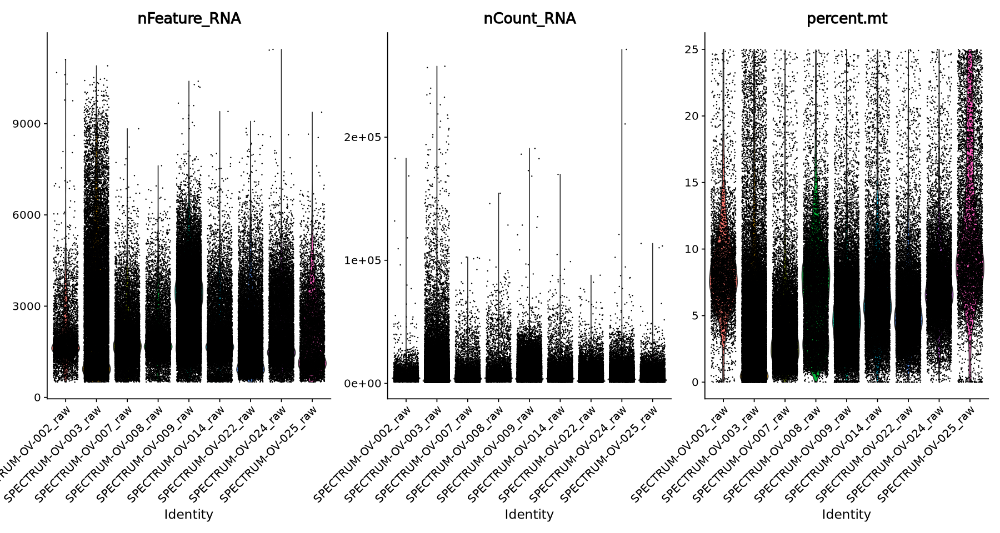

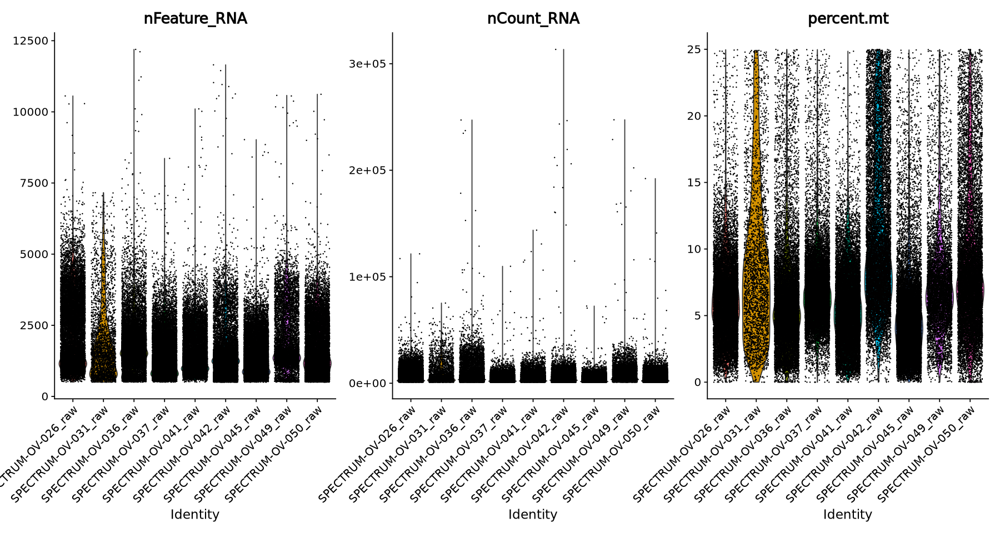

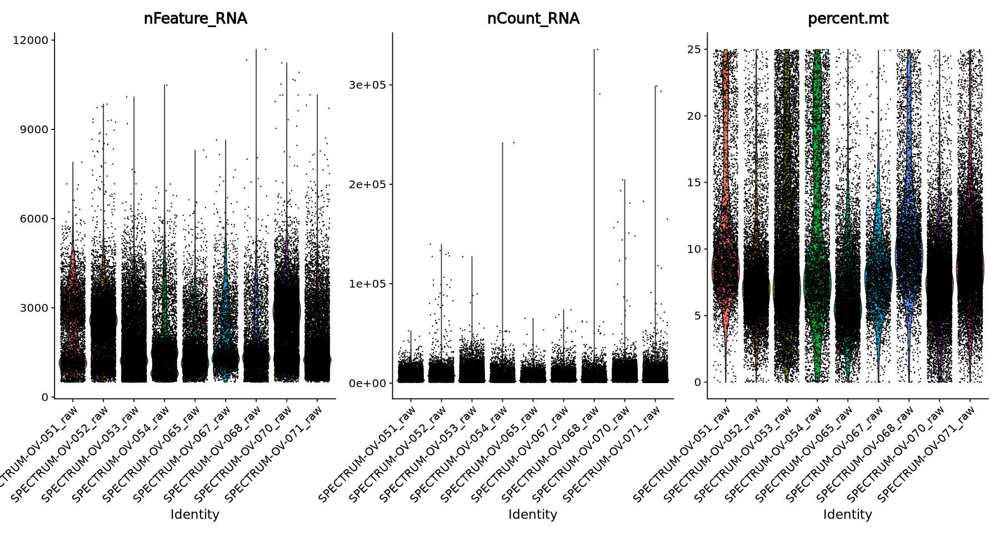

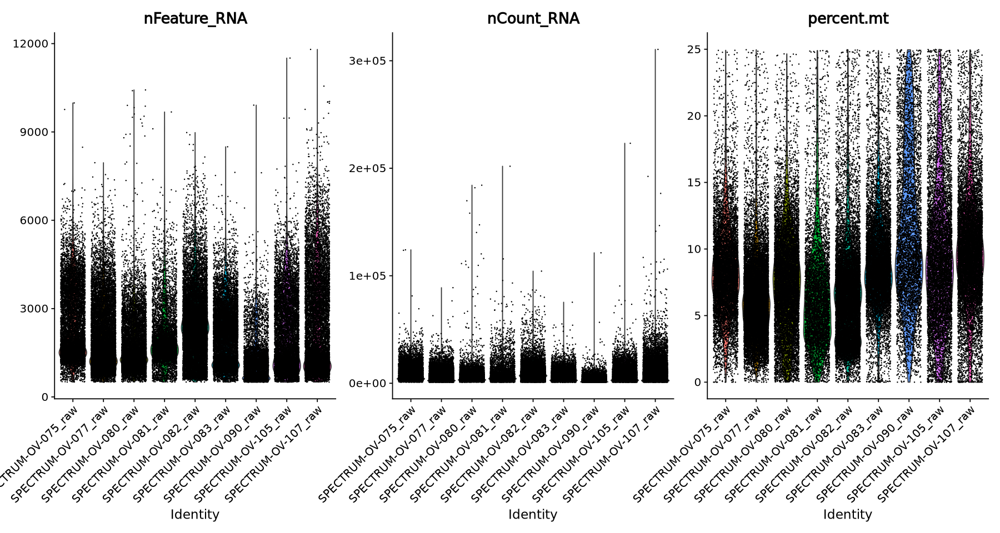

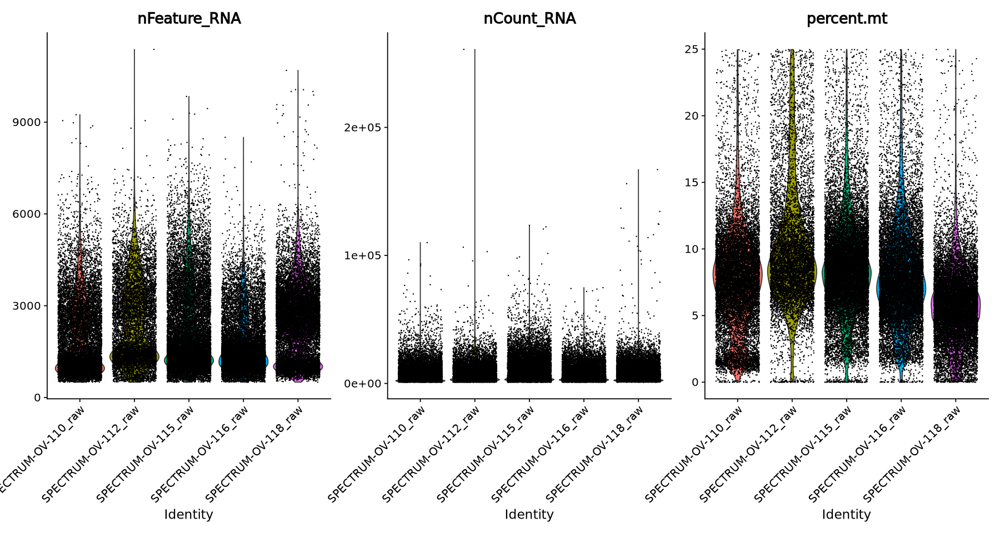

In [58]:
#QC Steps 
OC1.45[["percent.mt"]] <- PercentageFeatureSet(OC1.45, pattern = "^MT-")
#Visualise QC metrics
options(repr.plot.height=8, repr.plot.width=15)
VlnPlot(OC1.45, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

#QC Steps 
OC2.45[["percent.mt"]] <- PercentageFeatureSet(OC2.45, pattern = "^MT-")
#Visualise QC metrics
options(repr.plot.height=8, repr.plot.width=15)
VlnPlot(OC2.45, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

#QC Steps 
OC3.45[["percent.mt"]] <- PercentageFeatureSet(OC3.45, pattern = "^MT-")
#Visualise QC metrics
options(repr.plot.height=8, repr.plot.width=15)
VlnPlot(OC3.45, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

#QC Steps 
OC4.45[["percent.mt"]] <- PercentageFeatureSet(OC4.45, pattern = "^MT-")
#Visualise QC metrics
options(repr.plot.height=8, repr.plot.width=15)
VlnPlot(OC4.45, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

#QC Steps 
OC5.45[["percent.mt"]] <- PercentageFeatureSet(OC5.45, pattern = "^MT-")
#Visualise QC metrics
options(repr.plot.height=8, repr.plot.width=15)
VlnPlot(OC5.45, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

In [59]:
#Normalise the data
OC1.45 <- NormalizeData(OC1.45)
OC2.45 <- NormalizeData(OC2.45)
OC3.45 <- NormalizeData(OC3.45)
OC4.45 <- NormalizeData(OC4.45)
OC5.45 <- NormalizeData(OC5.45)

In [60]:
#Find variable features
OC1.45 <- FindVariableFeatures(OC1.45, selection.method = "vst", nfeatures = 2000)
OC2.45 <- FindVariableFeatures(OC2.45, selection.method = "vst", nfeatures = 2000)
OC3.45 <- FindVariableFeatures(OC3.45, selection.method = "vst", nfeatures = 2000)
OC4.45 <- FindVariableFeatures(OC4.45, selection.method = "vst", nfeatures = 2000)
OC5.45 <- FindVariableFeatures(OC5.45, selection.method = "vst", nfeatures = 2000)

In [61]:
#Scale the data
OC1.45 <- ScaleData(OC1.45, vars.to.regress = c("percent.mt", "nCount_RNA"))

Regressing out percent.mt, nCount_RNA

Centering and scaling data matrix



In [62]:
OC2.45 <- ScaleData(OC2.45, vars.to.regress = c("percent.mt", "nCount_RNA"))

Regressing out percent.mt, nCount_RNA

Centering and scaling data matrix



In [63]:
OC3.45 <- ScaleData(OC3.45, vars.to.regress = c("percent.mt", "nCount_RNA"))

Regressing out percent.mt, nCount_RNA

Centering and scaling data matrix



In [64]:
OC4.45 <- ScaleData(OC4.45, vars.to.regress = c("percent.mt", "nCount_RNA"))

Regressing out percent.mt, nCount_RNA

Centering and scaling data matrix



In [65]:
OC5.45 <- ScaleData(OC5.45, vars.to.regress = c("percent.mt", "nCount_RNA"))

Regressing out percent.mt, nCount_RNA

Centering and scaling data matrix



note above cell took ~1hr to run when all the samples run in one cell (this was before removing CD45neg)

In [66]:
#due to how long above took to run going to export out RDS now so I can read it in again if below steps crash
saveRDS(OC1.45, file = "/scratch/user/s4436039/scdata/GSE180661/OC1_45ongoing.RDS")
saveRDS(OC2.45, file = "/scratch/user/s4436039/scdata/GSE180661/OC2_45ongoing.RDS")
saveRDS(OC3.45, file = "/scratch/user/s4436039/scdata/GSE180661/OC3_45ongoing.RDS")
saveRDS(OC4.45, file = "/scratch/user/s4436039/scdata/GSE180661/OC4_45ongoing.RDS")
saveRDS(OC5.45, file = "/scratch/user/s4436039/scdata/GSE180661/OC5_45ongoing.RDS")

In [3]:
#Read in rds above
OC1.45 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/OC1_45ongoing.RDS")
OC2.45 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/OC2_45ongoing.RDS")
OC3.45 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/OC3_45ongoing.RDS")
OC4.45 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/OC4_45ongoing.RDS")
OC5.45 <- readRDS(file = "/scratch/user/s4436039/scdata/GSE180661/OC5_45ongoing.RDS")

In [4]:
#Run PCA
OC1.45 <- RunPCA(OC1.45, features = VariableFeatures(object = OC1.45))

PC_ 1 
Positive:  CALD1, FKBP10, COL1A2, EFEMP2, S100A16, CNN3, COL3A1, NNMT, COL1A1, C1S 
	   THY1, DCN, C1R, SPARC, PPIC, MYL9, RARRES2, TPM2, GPX8, SERPINH1 
	   COL6A2, COL5A2, CTHRC1, LUM, IGFBP2, COL6A1, ENAH, S100A13, CTTN, COL5A1 
Negative:  HLA-DQA1, IGKC, SPP1, CCL3, LYZ, APOC1, IGHG1, CCL3L1, MZB1, IGHG3 
	   CCL4L2, S100A9, FABP5, IL1B, HLA-DQA2, C15orf48, IRF8, IGHG4, HMOX1, FBP1 
	   CFD, SDS, TNFRSF17, IL1RN, CLEC5A, OSM, IGLC2, ACP5, S100A8, LTB 
PC_ 2 
Positive:  CLDN3, EPCAM, BCAM, CLDN16, CD24, CLDN4, MAL2, FOLR1, MUC16, SLC34A2 
	   ELF3, PRAME, S100A1, SOX17, UGT2B7, LCN2, WFDC2, CLDN7, KLK6, SMIM22 
	   KRT19, AP1M2, KCNK15, C2orf88, CRB3, EHF, C19orf33, DSP, BMP7, SYT10 
Negative:  COL3A1, SPARC, DCN, COL5A2, LUM, COL1A1, COL6A2, COL6A1, COL5A1, AEBP1 
	   FAP, PRRX1, COL6A3, POSTN, COL1A2, RARRES2, THBS2, CTSK, PCOLCE, BGN 
	   CDH11, NNMT, MMP2, RCN3, COL11A1, GJA1, CFH, FBN1, TDO2, MEG3 
PC_ 3 
Positive:  MKI67, TOP2A, UBE2C, ASPM, CENPF, TPX2, BIRC5, NUSAP1, 

In [5]:
OC2.45 <- RunPCA(OC2.45, features = VariableFeatures(object = OC2.45))

PC_ 1 
Positive:  CD14, CTSB, CST3, CD163, CTSL, GLUL, C1QA, APOE, GPNMB, C1QC 
	   C1QB, APOC1, LYZ, TMEM176B, TGFBI, PLAUR, DAB2, IFITM3, SERPING1, SGK1 
	   VSIG4, SLCO2B1, CTSD, LGMN, PLTP, OLR1, CPVL, SPP1, TMEM176A, LHFPL2 
Negative:  IGKC, MZB1, FKBP11, IGHG1, DERL3, ITM2C, JCHAIN, IGHG3, IGHG2, TENT5C 
	   OCIAD2, CD79A, TNFRSF17, RPL35A, FCRL5, CRIP1, GZMB, PIM2, SDC1, IGHG4 
	   C12orf75, GNLY, HIST1H4C, CCR7, POU2AF1, IGHM, JSRP1, XCL2, TMEM238, HIST1H1D 
PC_ 2 
Positive:  IGHG2, TNFRSF17, MZB1, DERL3, FCRL5, JCHAIN, IGLV3-1, JSRP1, FKBP11, IGHG3 
	   CD79A, IGHG1, IGKC, POU2AF1, SEC11C, XBP1, IGHG4, TENT5C, TP53INP1, SSR4 
	   IGHM, IGHA1, SDC1, FAM30A, IGHV3-15, IFI30, PIM2, LYZ, RAB30, PLEK 
Negative:  KRT19, WFDC2, EPCAM, SLPI, TM4SF1, BCAM, KRT8, MUC1, C19orf33, KRT18 
	   S100A13, SLC34A2, KLK7, S100A16, CP, NFIB, ELF3, KRT7, RBP1, FOLR1 
	   NNMT, MAL2, CLDN3, ASS1, LCN2, S100A2, MMP7, PBX1, CTGF, CYR61 
PC_ 3 
Positive:  IGHG1, IGHG3, JCHAIN, DERL3, IGHG2, IGKC, MZB1

In [6]:
OC3.45 <- RunPCA(OC3.45, features = VariableFeatures(object = OC3.45))

PC_ 1 
Positive:  CTSB, GPNMB, CTSL, RNASE1, TGFBI, IER3, OLR1, APOE, LYZ, APOC1 
	   DAB2, LGMN, PLTP, SPP1, HMOX1, CFD, FN1, CXCL2, MARCO, EGR1 
	   CXCL3, TIMP1, S100A9, C2, CXCL8, HBEGF, PLIN2, HLA-DQA1, ATF3, IL1B 
Negative:  EPCAM, CLDN3, KRT18, WFDC2, C19orf33, KRT8, BCAM, KRT19, TJP1, CLDN4 
	   PBX1, DSG2, LTB, DSP, CNN3, MDK, EMX2, TRBC1, SMIM22, OCIAD2 
	   CD24, SLPI, KRT7, PEG10, MAL2, S100A16, ELF3, CRIP2, PTPRF, CRABP2 
PC_ 2 
Positive:  MKI67, TOP2A, ASPM, GTSE1, NUSAP1, BIRC5, DLGAP5, TPX2, HMMR, UBE2C 
	   TYMS, PCLAF, CENPF, CDKN3, NCAPG, KIF11, AURKB, KNL1, CEP55, SPC25 
	   KIFC1, RRM2, CCNB2, KIF23, CCNA2, CDK1, KIF14, NUF2, HJURP, CDCA2 
Negative:  MDK, CTSB, RNASE1, GPNMB, CTSL, CNN3, TJP1, KRT8, CALD1, APOE 
	   WFDC2, PLTP, BCAM, EGR1, KRT18, EPCAM, PBX1, LGMN, CRABP2, CTTN 
	   KRT19, SELENOP, MYL9, S100A16, CLDN3, APOC1, DSP, PPIC, DSG2, DAB2 
PC_ 3 
Positive:  TOP2A, MKI67, ASPM, BIRC5, NUSAP1, TPX2, GTSE1, UBE2C, CENPF, DLGAP5 
	   HMMR, CDK1, STMN1, TYMS,

In [7]:
OC4.45 <- RunPCA(OC4.45, features = VariableFeatures(object = OC4.45))

PC_ 1 
Positive:  CTSB, CD163, TGFBI, LYZ, C1QA, C1QB, APOC1, CTSL, APOE, CST3 
	   GPNMB, PLAUR, SPP1, HMOX1, LGMN, RNASE1, PLTP, CTSD, SOD2, FN1 
	   CPVL, S100A9, FABP5, ACSL1, RHOB, C15orf48, CFD, IER3, PLIN2, IL4I1 
Negative:  BCAM, CLDN3, WFDC2, EPCAM, KRT8, KRT18, KRT19, KRT7, ELF3, C19orf33 
	   SLPI, ASS1, MUC1, MAL2, S100A13, CLDN4, SMIM22, DSP, FOLR1, DSG2 
	   CP, SOX17, LAPTM4B, S100A1, ARHGAP29, IGFBP2, PBX1, SCGB2A1, SLC34A2, CD24 
PC_ 2 
Positive:  CST3, CTSB, CTSL, CD163, GPNMB, CFD, PLAUR, LYZ, TIMP1, C1QA 
	   SOD2, PLTP, CTSD, APOE, PLIN2, C1QB, IFITM3, S100A9, HMOX1, APOC1 
	   RNASE1, NUPR1, IER3, LGMN, MARCO, FN1, SERPING1, CPVL, VEGFA, RHOB 
Negative:  MKI67, TOP2A, ASPM, NUSAP1, UBE2C, TPX2, TYMS, BIRC5, GTSE1, CENPF 
	   DLGAP5, PCLAF, HMMR, CDK1, NCAPG, KIF11, CDKN3, KNL1, RRM2, CCNA2 
	   AURKB, CCNB2, SPC25, ZWINT, KIF23, KIFC1, CEP55, KIF2C, NUF2, BUB1B 
PC_ 3 
Positive:  MKI67, TOP2A, ASPM, UBE2C, BIRC5, NUSAP1, TPX2, GTSE1, CDK1, DLGAP5 
	   HMMR, CENPF,

In [8]:
OC5.45 <- RunPCA(OC5.45, features = VariableFeatures(object = OC5.45))

PC_ 1 
Positive:  MZB1, IGHG1, JCHAIN, DERL3, IGHG3, FKBP11, IGKC, ITM2C, TNFRSF17, IGHG4 
	   TENT5C, NKG7, FCRL5, IGHG2, IGLC2, SDC1, CD79A, PIM2, SSR4, IGLC3 
	   POU2AF1, SEC11C, LTB, IGHGP, CTSW, JSRP1, GZMK, AC012236.1, PRF1, XBP1 
Negative:  CTSB, CST3, CD163, GLUL, CTSL, APOE, APOC1, VSIG4, GPNMB, TGFBI 
	   LYZ, CPVL, PLAUR, PLTP, DAB2, LIPA, CTSD, SOD2, SLC11A1, IFITM3 
	   LGMN, ABCA1, IER3, TREM2, SGK1, SPP1, RNASE1, FN1, CFD, GSN 
PC_ 2 
Positive:  TOP2A, MKI67, UBE2C, BIRC5, GTSE1, ASPM, NUSAP1, TPX2, CDK1, TYMS 
	   HMMR, DLGAP5, CENPF, NCAPG, PCLAF, AURKB, CDKN3, RRM2, STMN1, CCNB2 
	   KIF11, KIFC1, KIF23, KNL1, NUF2, ZWINT, KIF2C, SPC25, CENPA, KIF15 
Negative:  IGHG1, IGHG3, JCHAIN, DERL3, MZB1, TNFRSF17, IGHG2, IGKC, XBP1, SDC1 
	   FCRL5, JSRP1, IGHG4, IGHGP, FKBP11, SSR4, IGLC2, SPAG4, CD79A, AC012236.1 
	   IGLC3, DPEP1, FAM92B, TP53INP1, IGLV3-1, SELENOM, PRDX4, CAV1, CFD, POU2AF1 
PC_ 3 
Positive:  KRT8, KRT18, SLPI, WFDC2, KRT19, BCAM, ASS1, MDK, EPCAM, CLDN3 

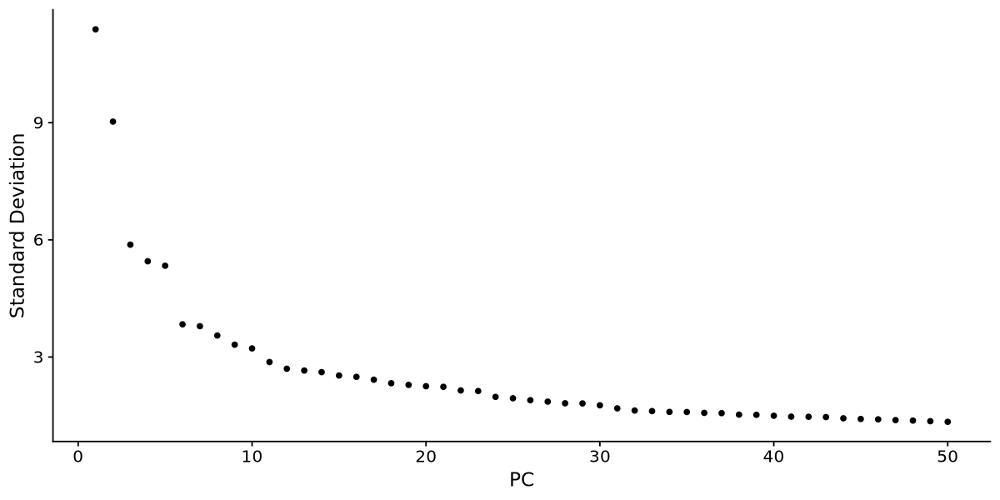

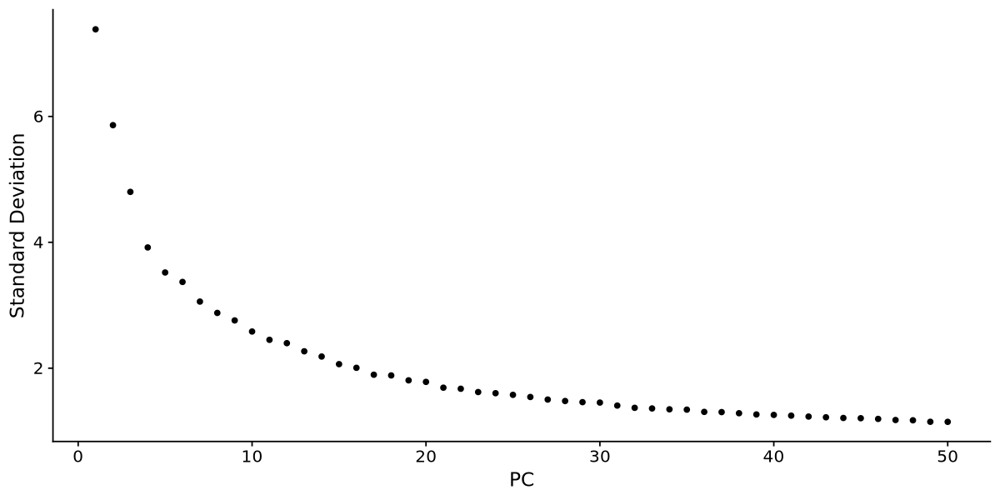

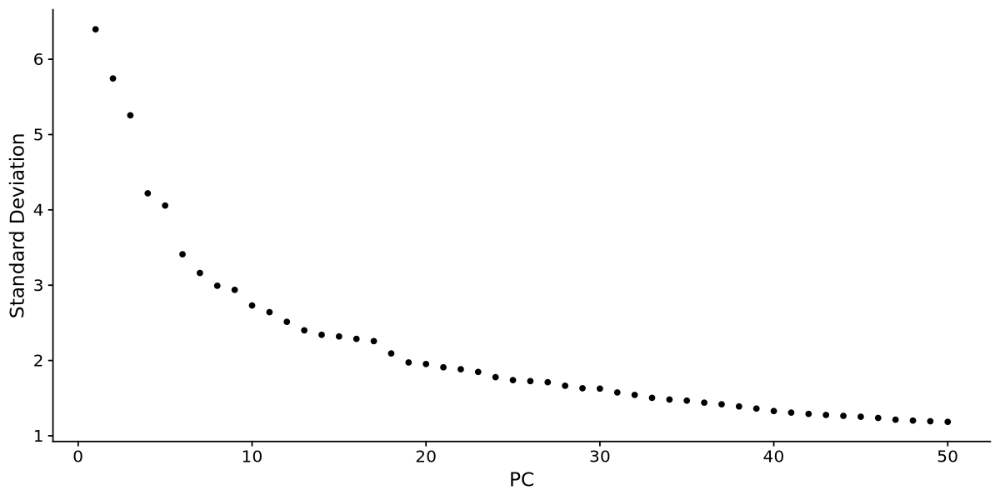

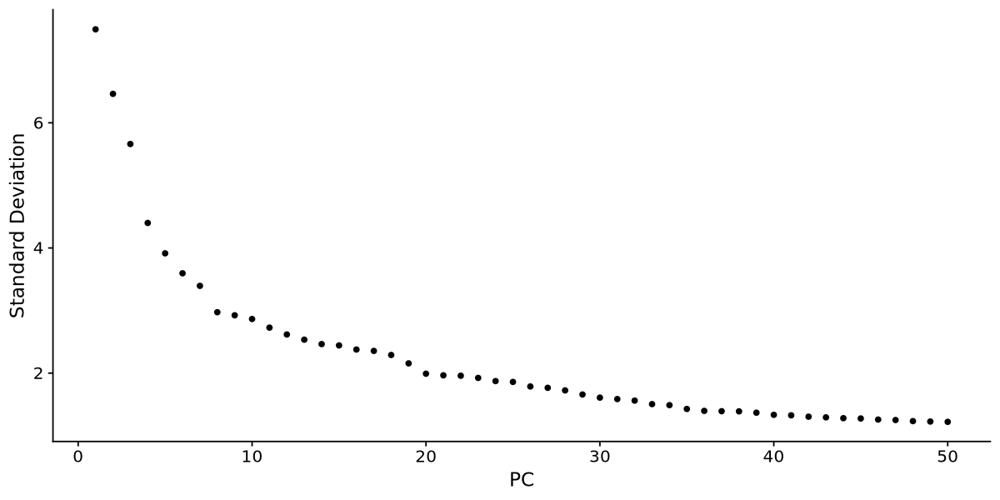

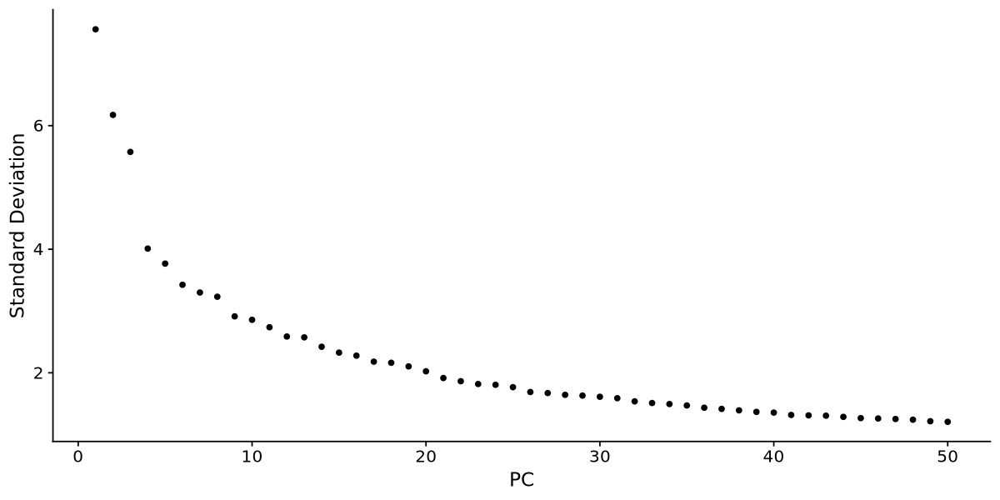

In [9]:
#make elbow plot
options(repr.plot.height=5, repr.plot.width=10)
ElbowPlot(OC1.45, ndims=50)
ElbowPlot(OC2.45, ndims=50)
ElbowPlot(OC3.45, ndims=50)
ElbowPlot(OC4.45, ndims=50)
ElbowPlot(OC5.45, ndims=50)
#in GSE213243 decided to use 40 PC, staying consistent across datasets

In [10]:
#Find neighbours (make sure number matches no. features chosen above)
OC1.45 <- FindNeighbors(OC1.45, dims = 1:40)

Computing nearest neighbor graph

Computing SNN



In [11]:
OC2.45 <- FindNeighbors(OC2.45, dims = 1:40)

Computing nearest neighbor graph

Computing SNN



In [12]:
OC3.45 <- FindNeighbors(OC3.45, dims = 1:40)

Computing nearest neighbor graph

Computing SNN



In [13]:
OC4.45 <- FindNeighbors(OC4.45, dims = 1:40)

Computing nearest neighbor graph

Computing SNN



In [14]:
OC5.45 <- FindNeighbors(OC5.45, dims = 1:40)

Computing nearest neighbor graph

Computing SNN



In [15]:
#Run UMAP
OC1.45 <- RunUMAP(OC1.45, dims = 1:40)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
14:21:57 UMAP embedding parameters a = 0.9922 b = 1.112

14:21:57 Read 149760 rows and found 40 numeric columns

14:21:57 Using Annoy for neighbor search, n_neighbors = 30

14:21:57 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%



[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:22:08 Writing NN index file to temp file /scratch/temp/9858890/RtmpuCRBEM/file2d55924f3f13e2

14:22:08 Searching Annoy index using 1 thread, search_k = 3000

14:22:58 Annoy recall = 100%

14:22:58 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

14:23:02 Initializing from normalized Laplacian + noise (using RSpectra)

14:23:21 Commencing optimization for 200 epochs, with 6939414 positive edges

14:24:16 Optimization finished



In [16]:
OC2.45 <- RunUMAP(OC2.45, dims = 1:40)

14:24:16 UMAP embedding parameters a = 0.9922 b = 1.112

14:24:16 Read 118757 rows and found 40 numeric columns

14:24:16 Using Annoy for neighbor search, n_neighbors = 30

14:24:16 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:24:25 Writing NN index file to temp file /scratch/temp/9858890/RtmpuCRBEM/file2d5592ff2a3c4

14:24:25 Searching Annoy index using 1 thread, search_k = 3000

14:25:07 Annoy recall = 100%

14:25:07 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

14:25:10 Initializing from normalized Laplacian + noise (using RSpectra)

14:25:22 Commencing optimization for 200 epochs, with 5632706 positive edges

14:26:06 Optimization finished



In [17]:
OC3.45 <- RunUMAP(OC3.45, dims = 1:40)

14:26:06 UMAP embedding parameters a = 0.9922 b = 1.112

14:26:06 Read 73097 rows and found 40 numeric columns

14:26:06 Using Annoy for neighbor search, n_neighbors = 30

14:26:06 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:26:11 Writing NN index file to temp file /scratch/temp/9858890/RtmpuCRBEM/file2d55925257b93f

14:26:11 Searching Annoy index using 1 thread, search_k = 3000

14:26:34 Annoy recall = 100%

14:26:34 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

14:26:36 Initializing from normalized Laplacian + noise (using RSpectra)

14:26:41 Commencing optimization for 200 epochs, with 3403002 positive edges

14:27:08 Optimization finished



In [18]:
OC4.45 <- RunUMAP(OC4.45, dims = 1:40)

14:27:08 UMAP embedding parameters a = 0.9922 b = 1.112

14:27:08 Read 97206 rows and found 40 numeric columns

14:27:08 Using Annoy for neighbor search, n_neighbors = 30

14:27:08 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:27:15 Writing NN index file to temp file /scratch/temp/9858890/RtmpuCRBEM/file2d559294e9ee8

14:27:15 Searching Annoy index using 1 thread, search_k = 3000

14:27:47 Annoy recall = 100%

14:27:47 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

14:27:50 Initializing from normalized Laplacian + noise (using RSpectra)

14:28:03 Commencing optimization for 200 epochs, with 4508978 positive edges

14:28:39 Optimization finished



In [19]:
OC5.45 <- RunUMAP(OC5.45, dims = 1:40)

14:28:39 UMAP embedding parameters a = 0.9922 b = 1.112

14:28:39 Read 68163 rows and found 40 numeric columns

14:28:39 Using Annoy for neighbor search, n_neighbors = 30

14:28:39 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:28:44 Writing NN index file to temp file /scratch/temp/9858890/RtmpuCRBEM/file2d559273aa5119

14:28:44 Searching Annoy index using 1 thread, search_k = 3000

14:29:05 Annoy recall = 100%

14:29:05 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

14:29:07 Initializing from normalized Laplacian + noise (using RSpectra)

14:29:12 Commencing optimization for 200 epochs, with 3131298 positive edges

14:29:36 Optimization finished



In [20]:
#Cluster, resolution here set to 0.2
OC1.45 <- FindClusters(OC1.45, resolution = 0.2)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 149760
Number of edges: 4784671

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9571
Number of communities: 22
Elapsed time: 59 seconds


2 singletons identified. 20 final clusters.



In [21]:
OC2.45 <- FindClusters(OC2.45, resolution = 0.2)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 118757
Number of edges: 3874217

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9536
Number of communities: 19
Elapsed time: 39 seconds


3 singletons identified. 16 final clusters.



In [22]:
OC3.45 <- FindClusters(OC3.45, resolution = 0.2)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 73097
Number of edges: 2621360

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9509
Number of communities: 14
Elapsed time: 18 seconds


In [23]:
OC4.45 <- FindClusters(OC4.45, resolution = 0.2)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 97206
Number of edges: 3254179

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9531
Number of communities: 18
Elapsed time: 36 seconds


2 singletons identified. 16 final clusters.



In [24]:
OC5.45 <- FindClusters(OC5.45, resolution = 0.2)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 68163
Number of edges: 2388307

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9517
Number of communities: 15
Elapsed time: 18 seconds


Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



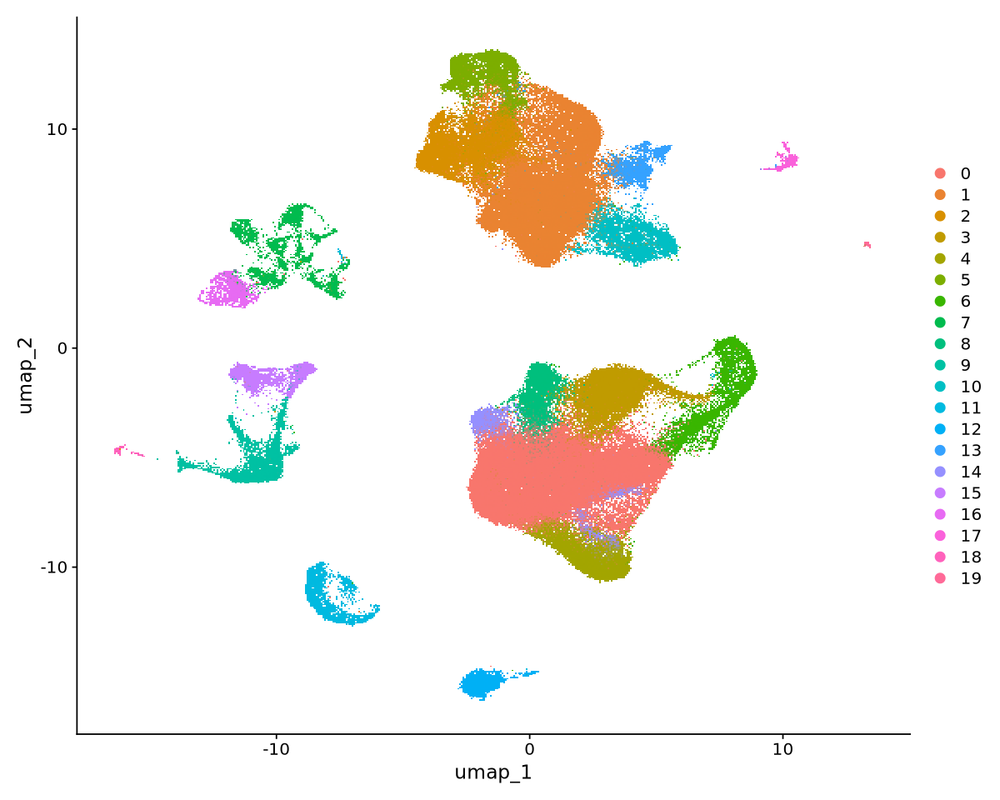

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



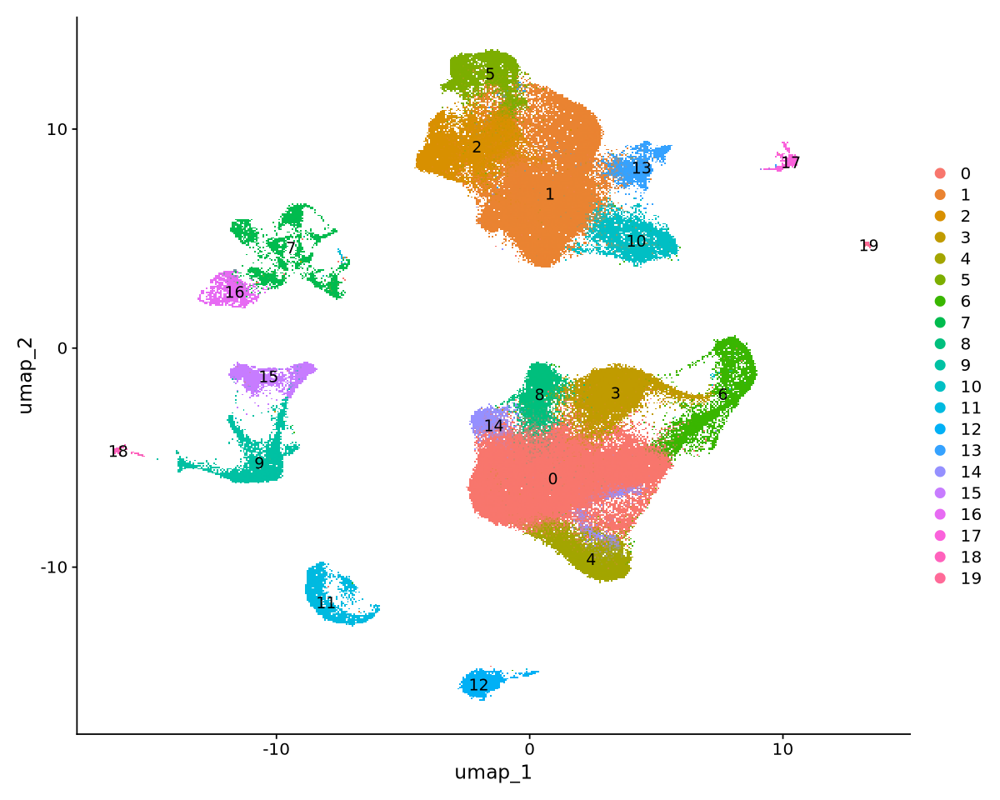

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



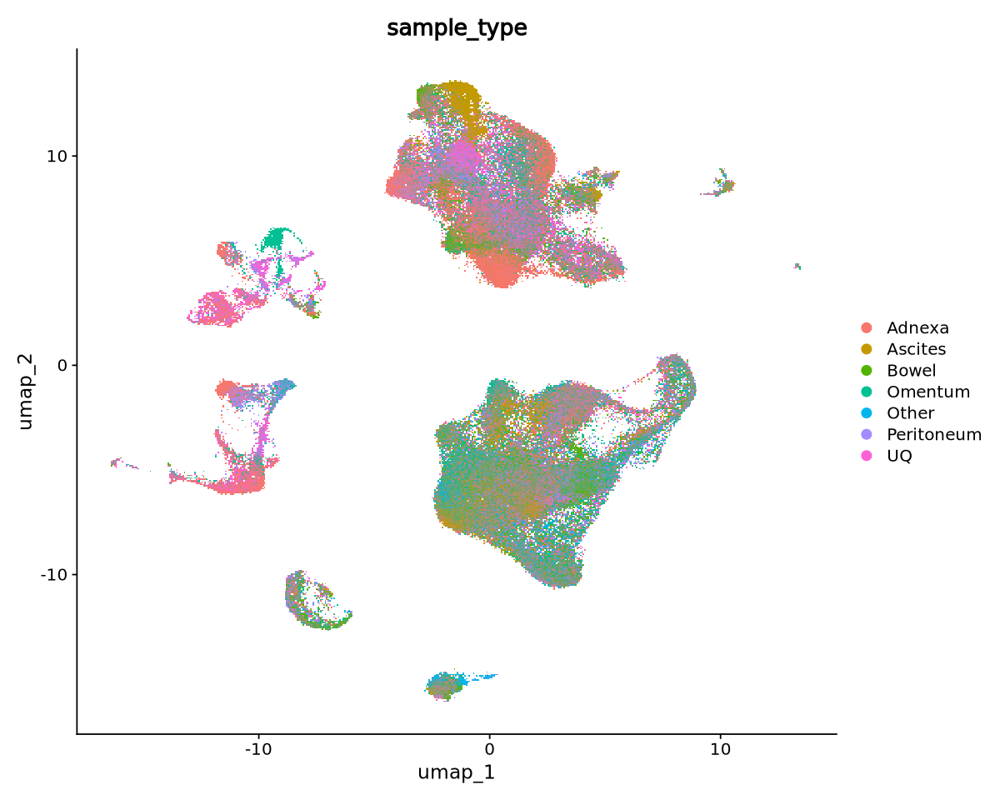

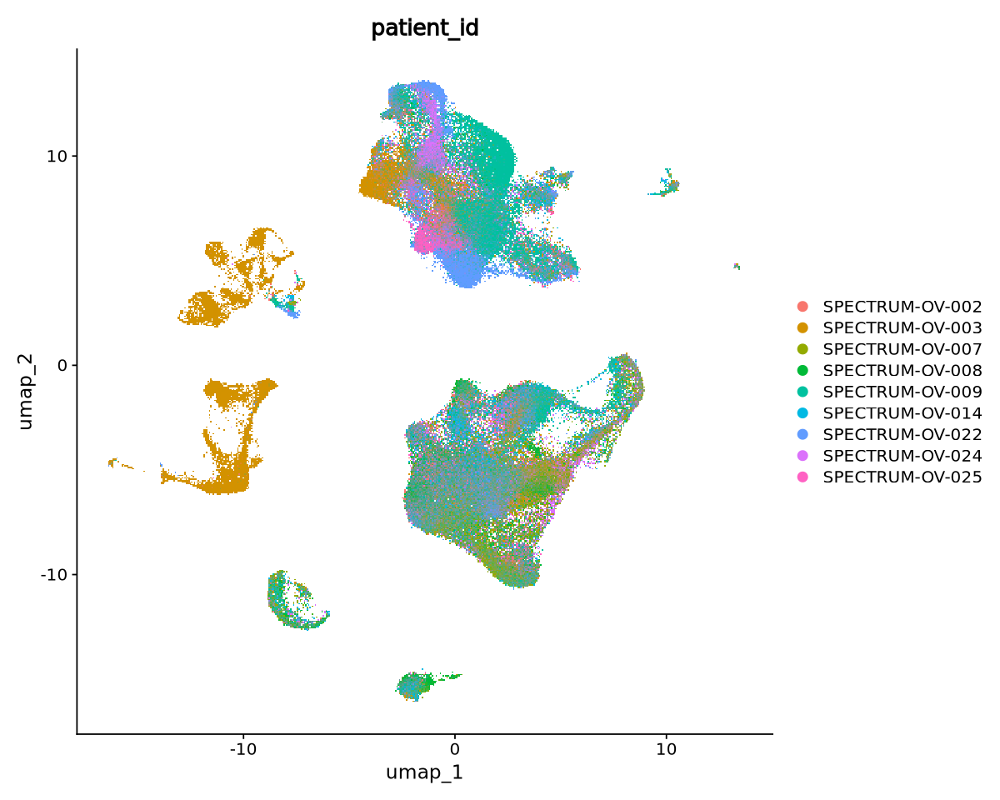

In [25]:
#Plot UMAP
options(repr.plot.height=8, repr.plot.width=10)
DimPlot(OC1.45, reduction = "umap")
DimPlot(OC1.45, reduction = "umap", label=TRUE)
DimPlot(OC1.45, reduction = "umap", group = "sample_type")
DimPlot(OC1.45, reduction = "umap", group = "patient_id")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



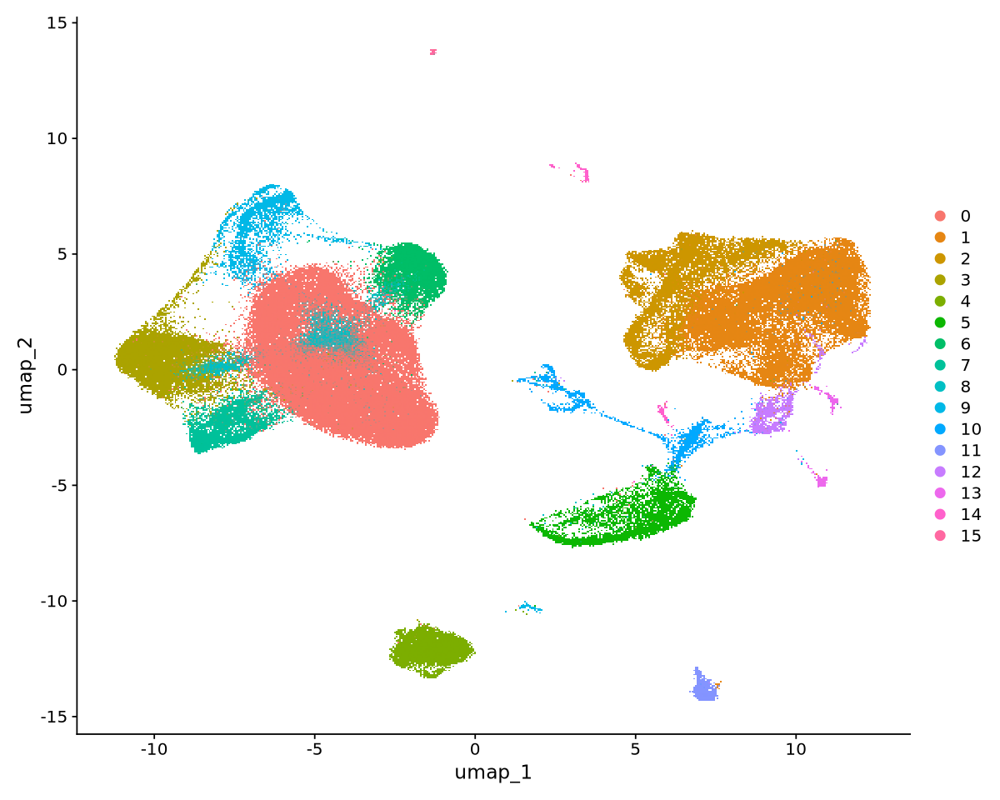

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



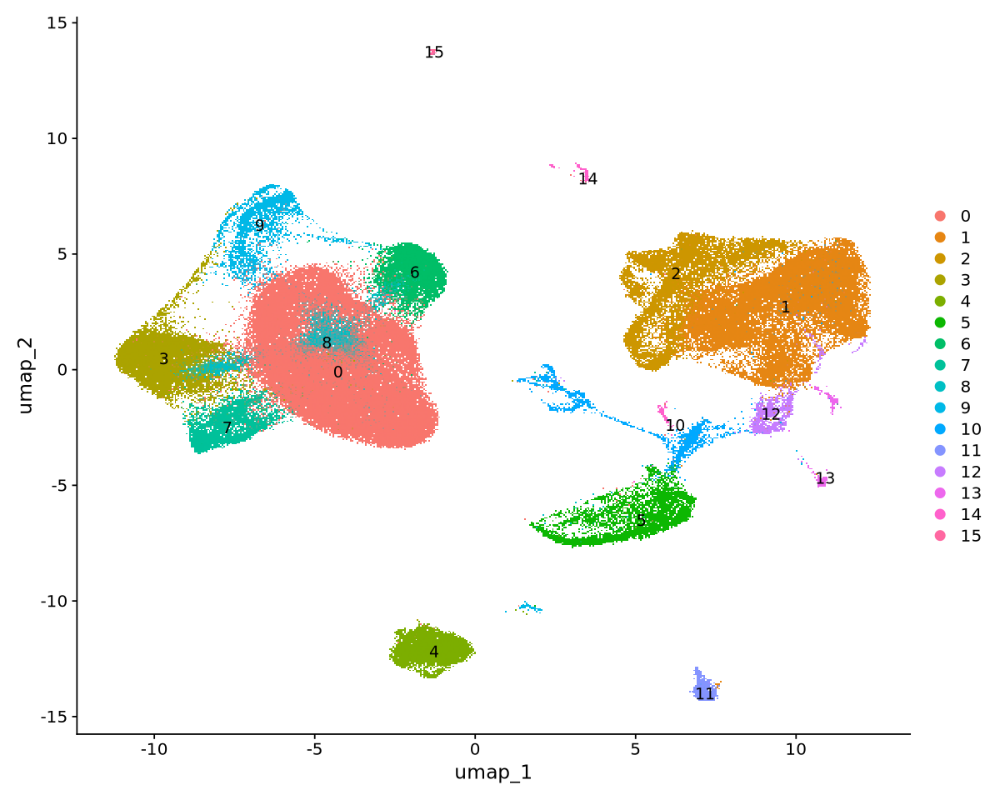

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



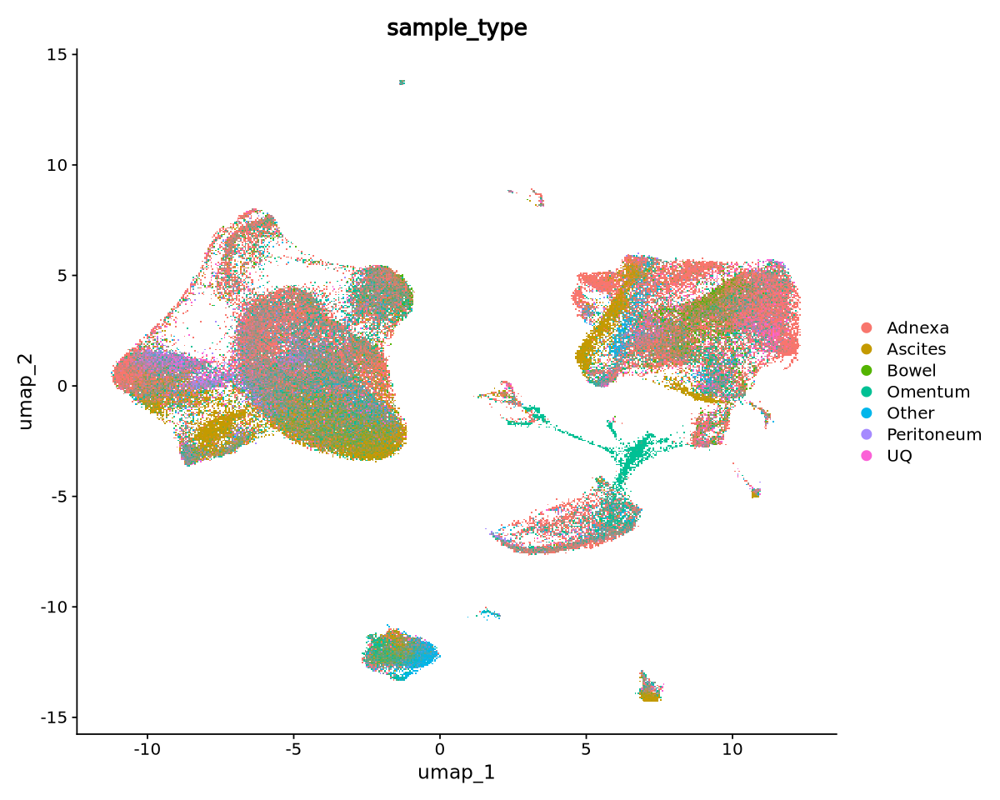

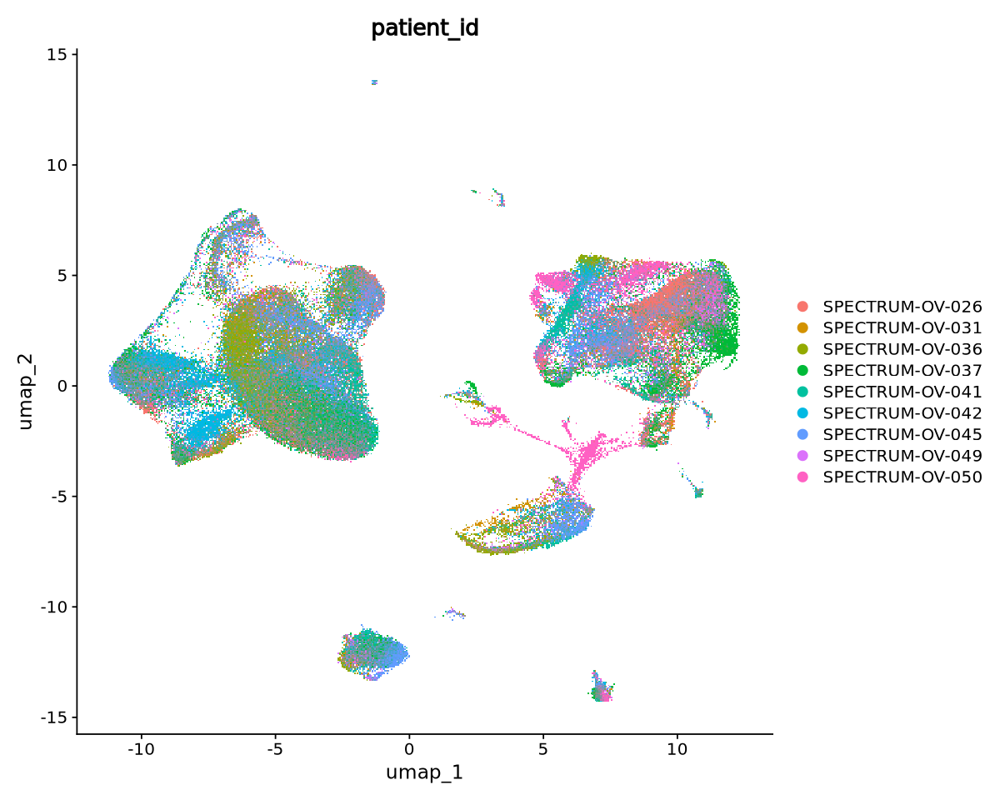

In [26]:
#Plot UMAP
options(repr.plot.height=8, repr.plot.width=10)
DimPlot(OC2.45, reduction = "umap")
DimPlot(OC2.45, reduction = "umap", label=TRUE)
DimPlot(OC2.45, reduction = "umap", group = "sample_type")
DimPlot(OC2.45, reduction = "umap", group = "patient_id")

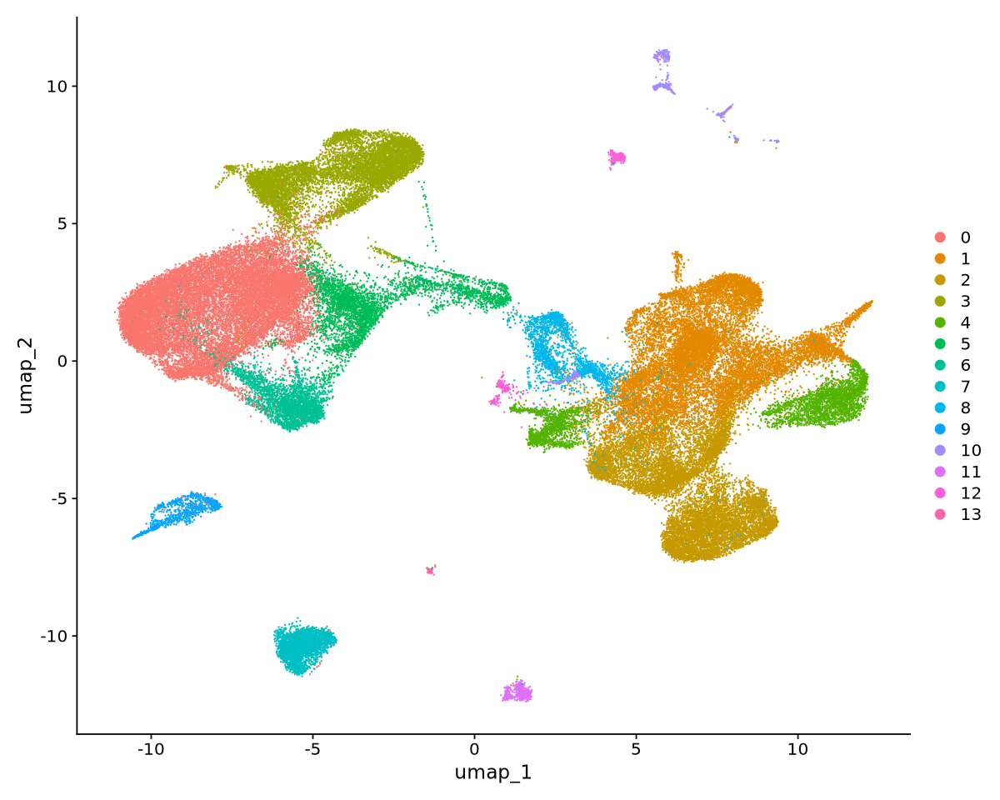

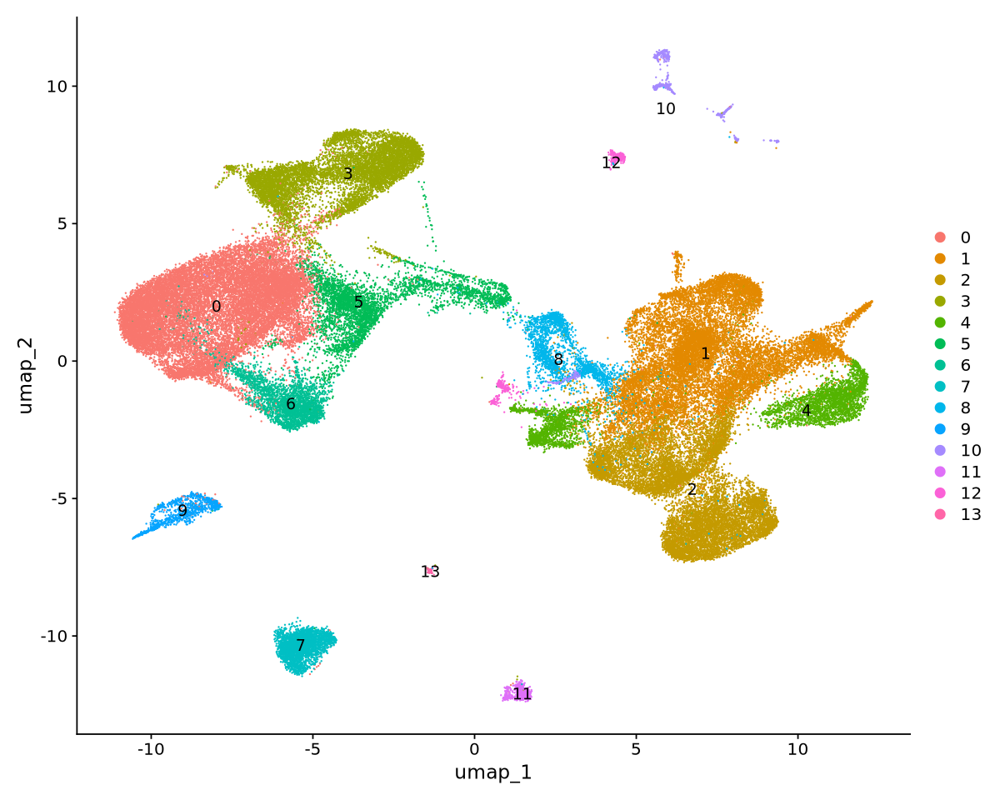

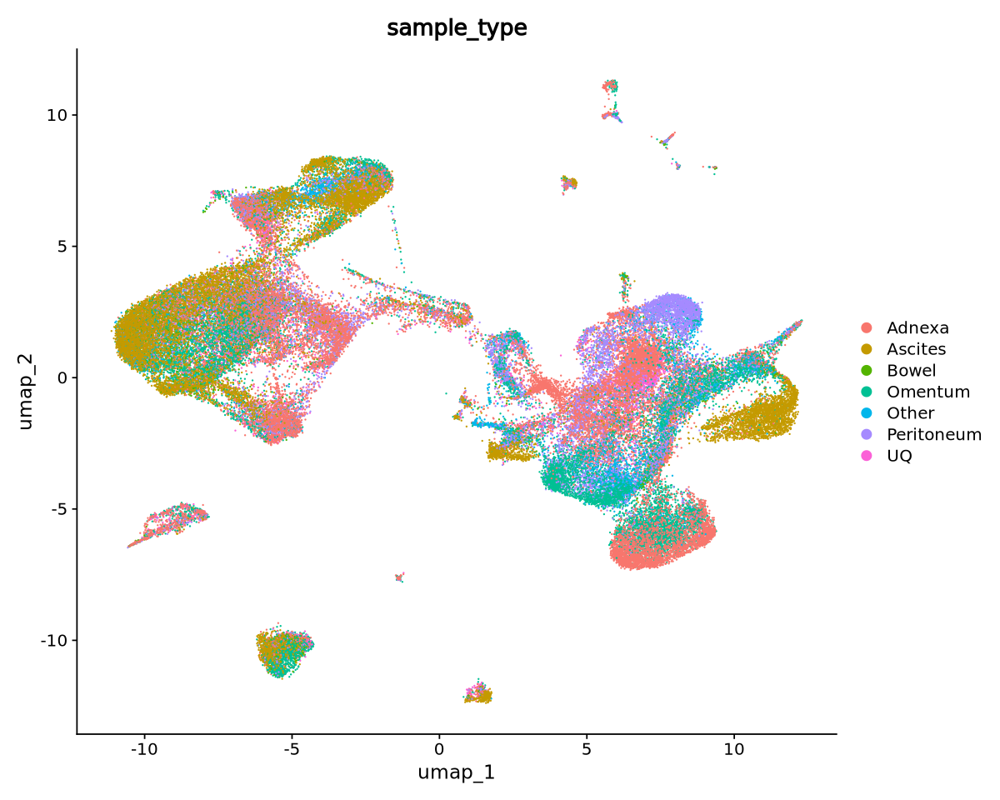

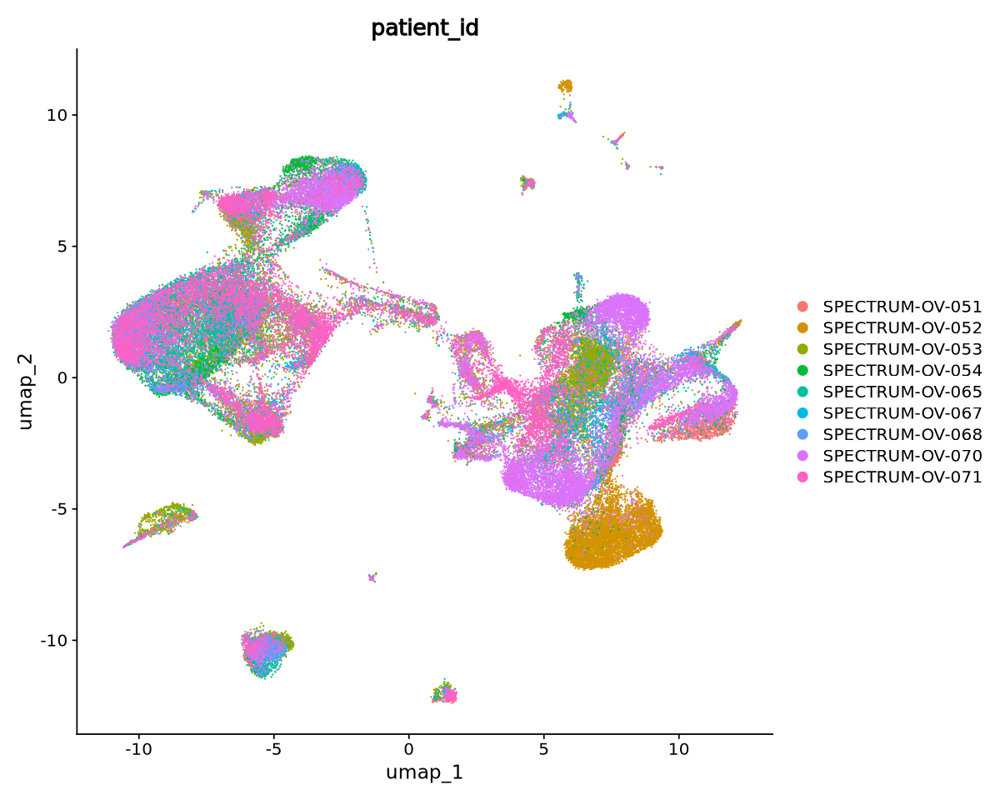

In [27]:
#Plot UMAP
options(repr.plot.height=8, repr.plot.width=10)
DimPlot(OC3.45, reduction = "umap")
DimPlot(OC3.45, reduction = "umap", label=TRUE)
DimPlot(OC3.45, reduction = "umap", group = "sample_type")
DimPlot(OC3.45, reduction = "umap", group = "patient_id")

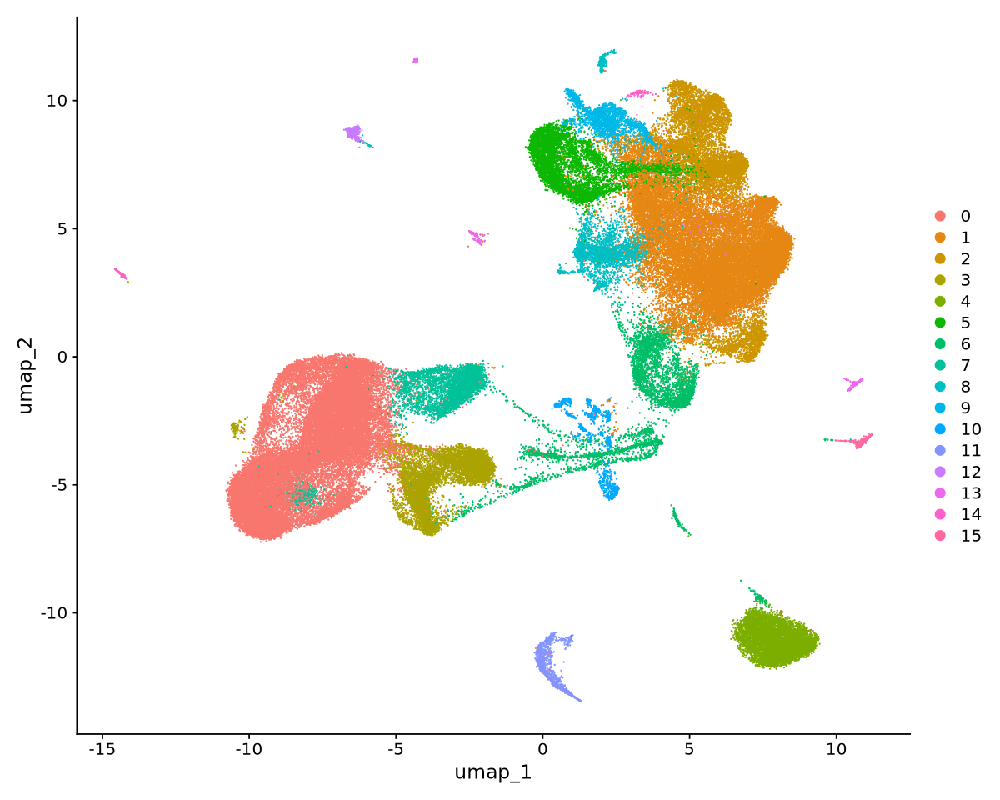

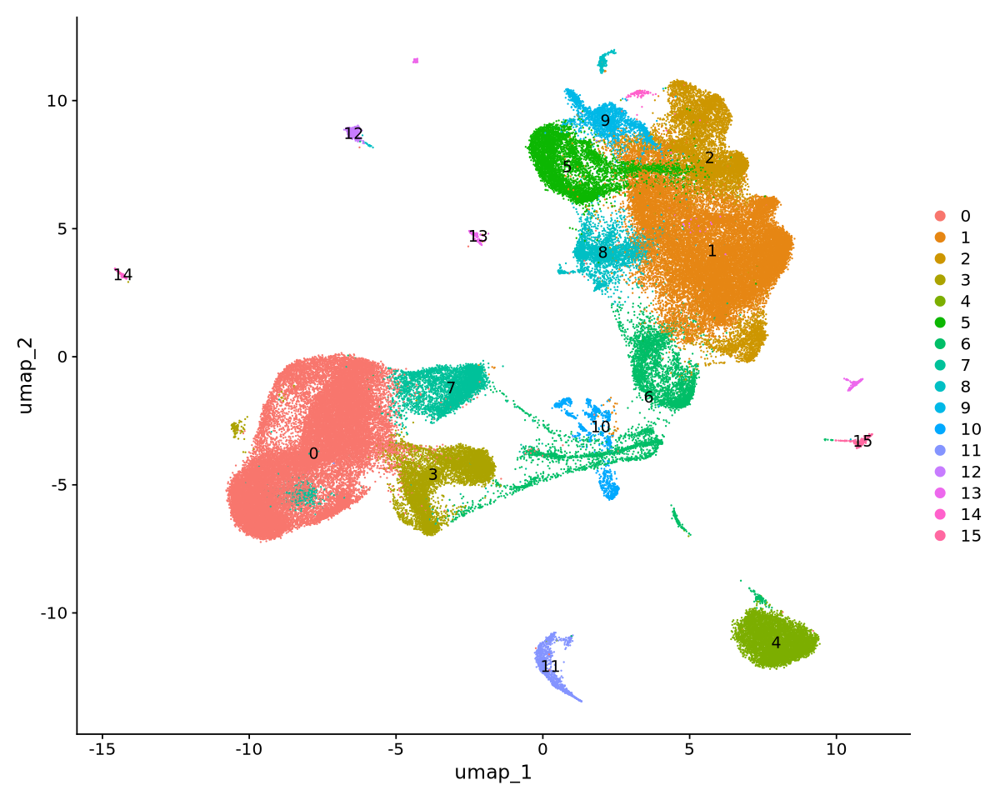

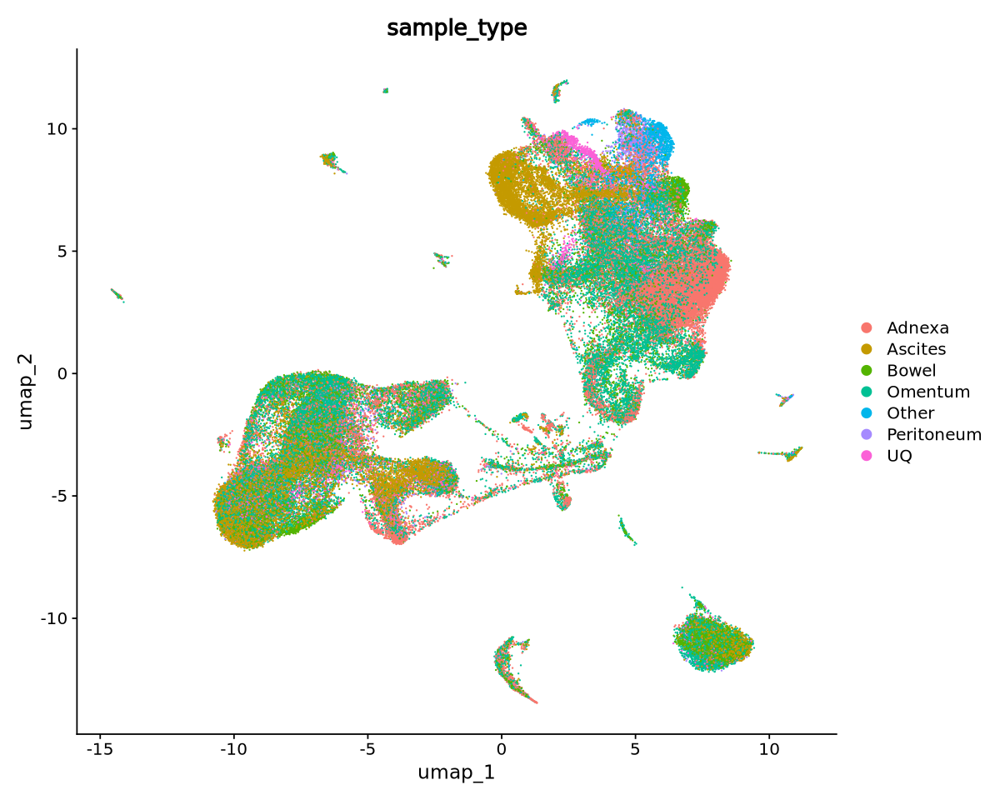

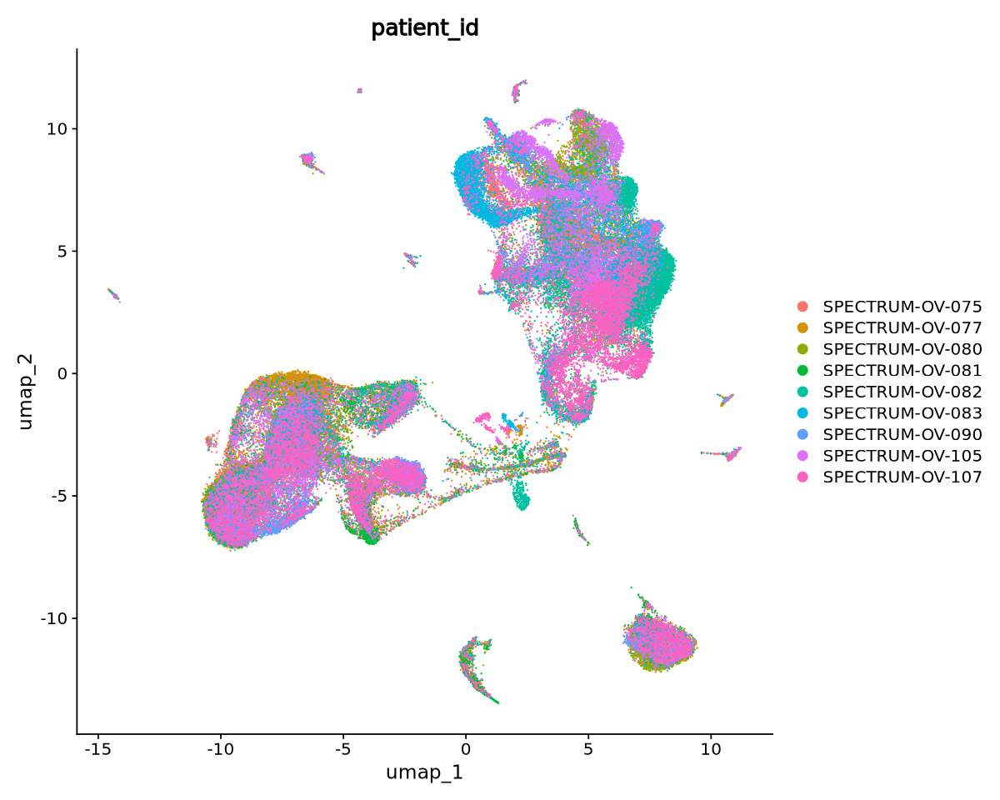

In [28]:
#Plot UMAP
options(repr.plot.height=8, repr.plot.width=10)
DimPlot(OC4.45, reduction = "umap")
DimPlot(OC4.45, reduction = "umap", label=TRUE)
DimPlot(OC4.45, reduction = "umap", group = "sample_type")
DimPlot(OC4.45, reduction = "umap", group = "patient_id")

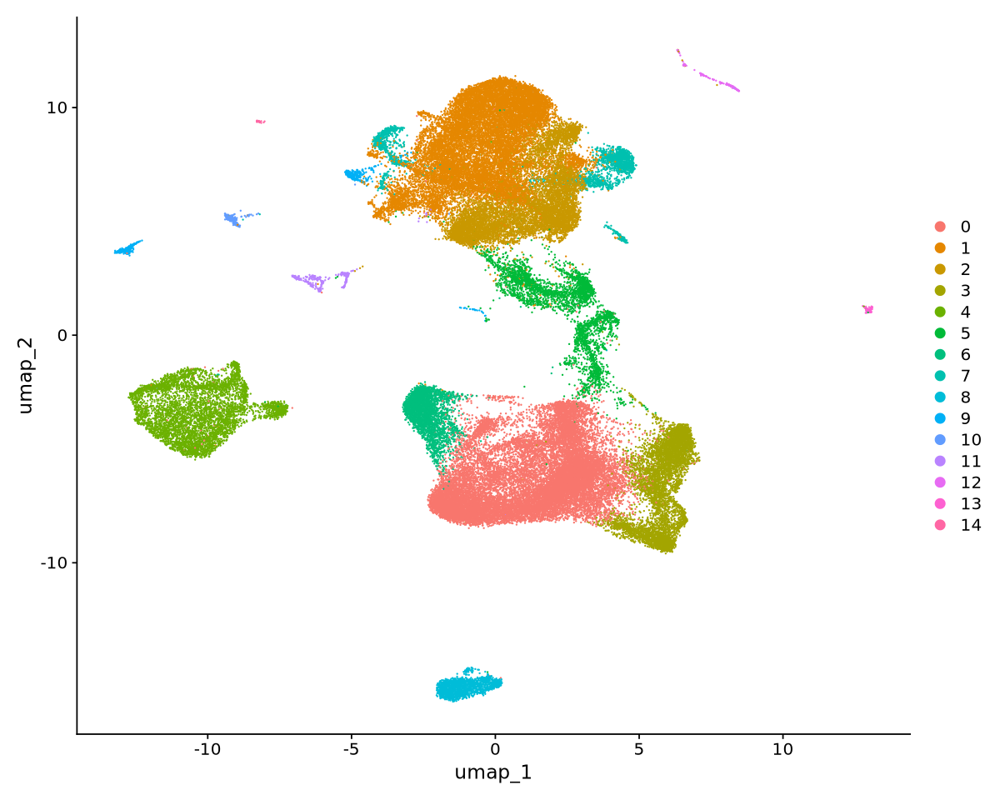

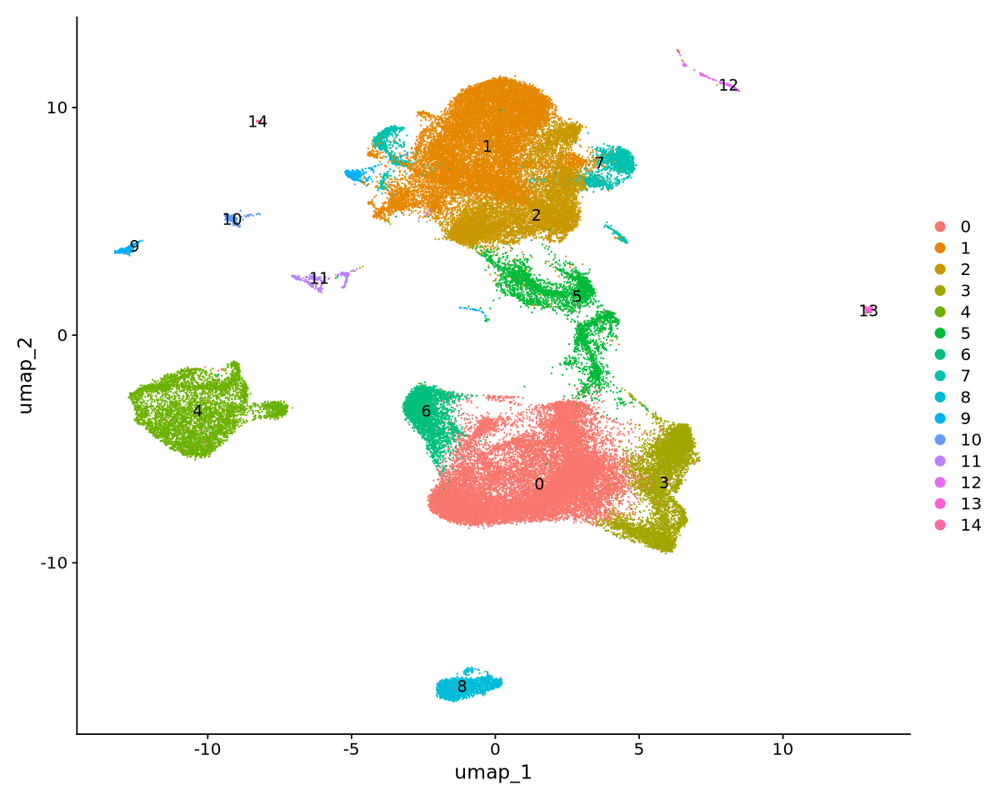

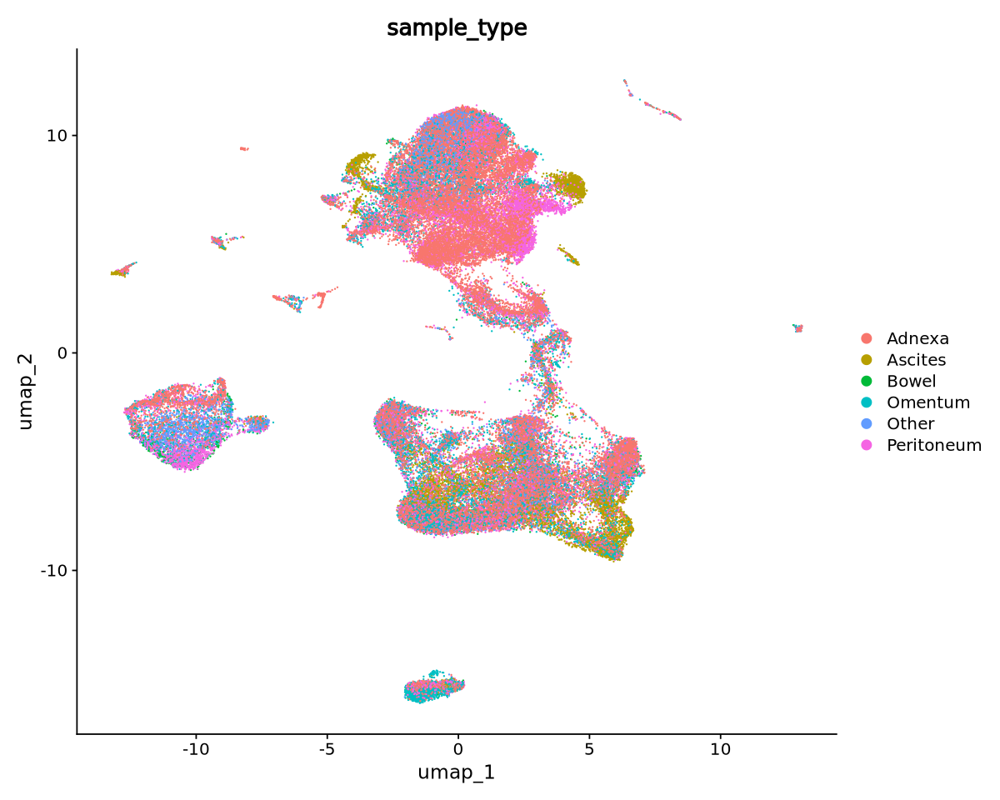

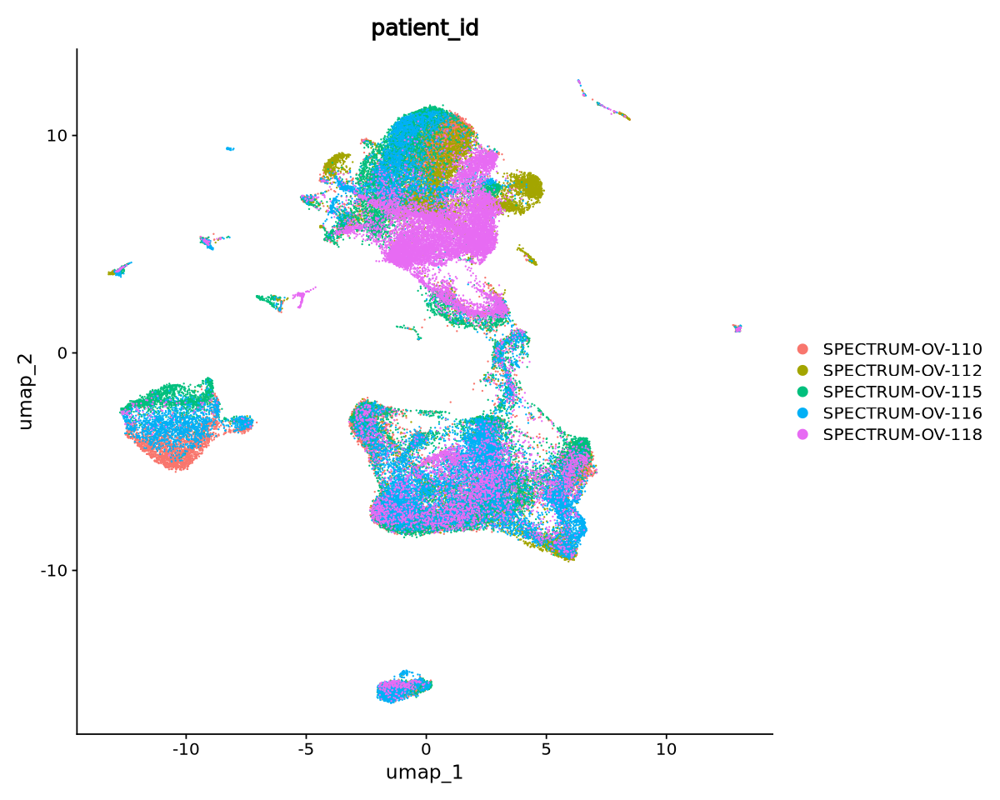

In [29]:
#Plot UMAP
options(repr.plot.height=8, repr.plot.width=10)
DimPlot(OC5.45, reduction = "umap")
DimPlot(OC5.45, reduction = "umap", label=TRUE)
DimPlot(OC5.45, reduction = "umap", group = "sample_type")
DimPlot(OC5.45, reduction = "umap", group = "patient_id")

In [30]:
#Save the object at this point so it can be loaded in without running steps above
saveRDS(OC1.45, file = "/scratch/user/s4436039/scdata/GSE180661/GSE180661_OC1.RDS")
saveRDS(OC2.45, file = "/scratch/user/s4436039/scdata/GSE180661/GSE180661_OC2.RDS")
saveRDS(OC3.45, file = "/scratch/user/s4436039/scdata/GSE180661/GSE180661_OC3.RDS")
saveRDS(OC4.45, file = "/scratch/user/s4436039/scdata/GSE180661/GSE180661_OC4.RDS")
saveRDS(OC5.45, file = "/scratch/user/s4436039/scdata/GSE180661/GSE180661_OC5.RDS")

#### Next part of code is about determining which cluster is the myeloid cells

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To di

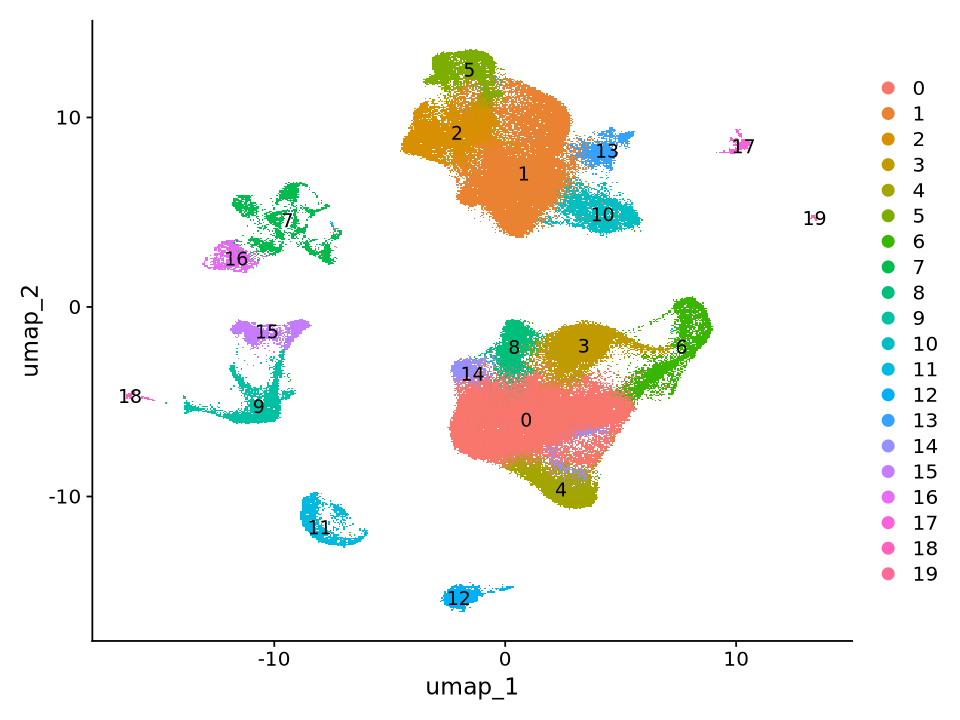

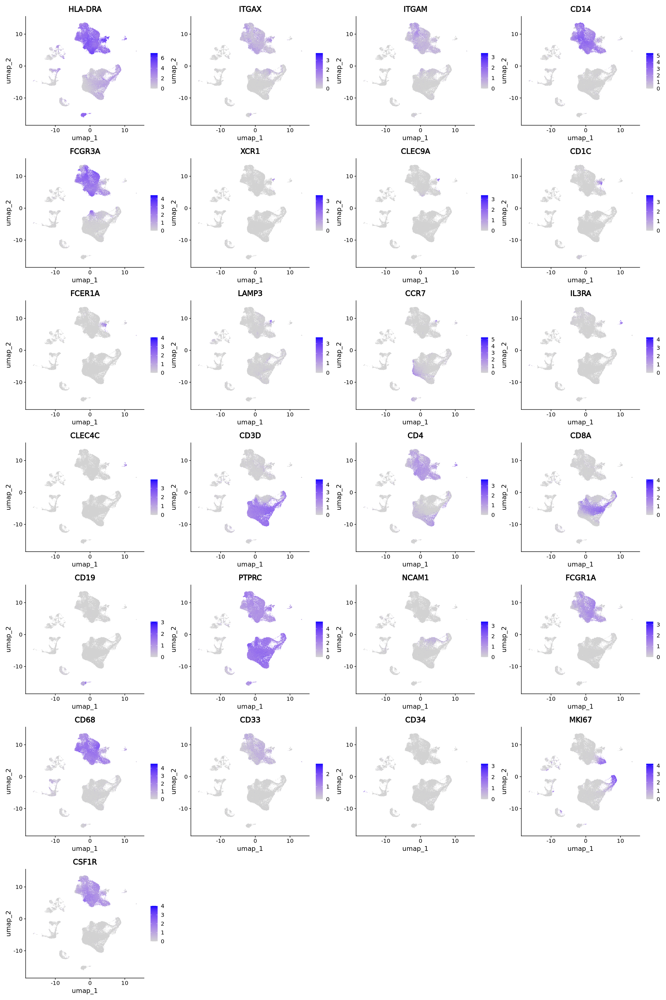

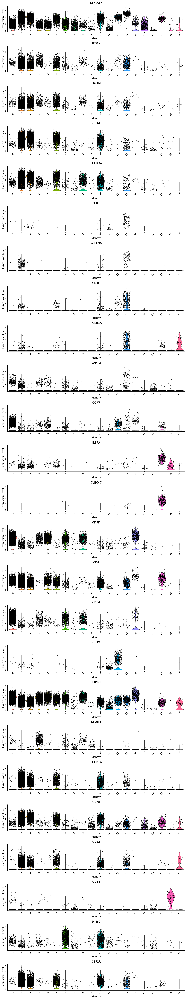

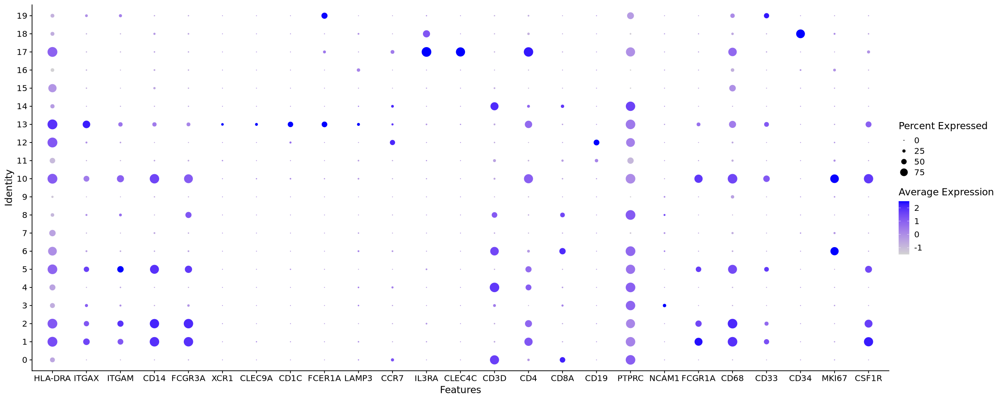

In [31]:
#Same genes over UMAP
options(repr.plot.height=6, repr.plot.width=8)
DimPlot(OC1.45, reduction = "umap", label=TRUE)

options(repr.plot.height=30, repr.plot.width=20)
FeaturePlot(OC1.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"), order = TRUE)

#Violin plots of classic markers
options(repr.plot.height=80, repr.plot.width=15)
VlnPlot(OC1.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"), ncol=1)

#Same as above but dot plot
options(repr.plot.height=8, repr.plot.width=20)
DotPlot(OC1.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"))

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To di

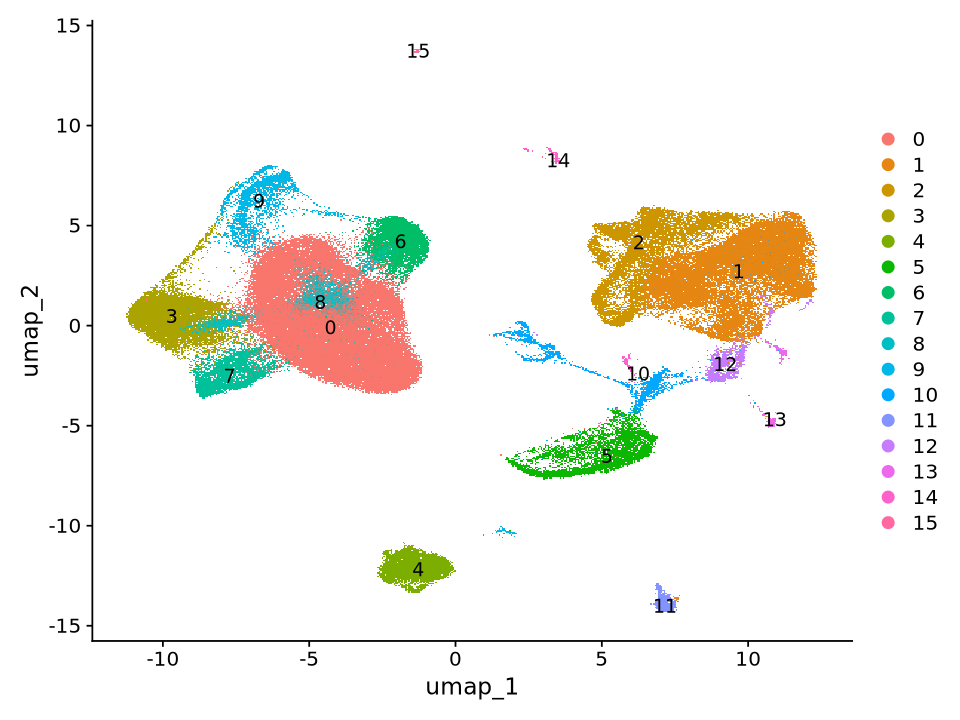

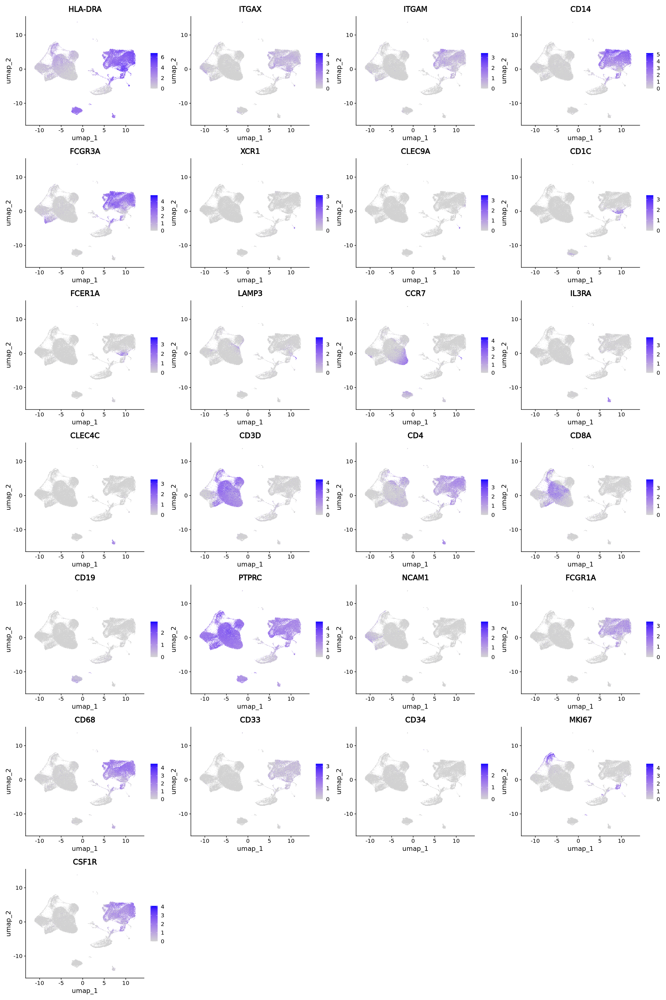

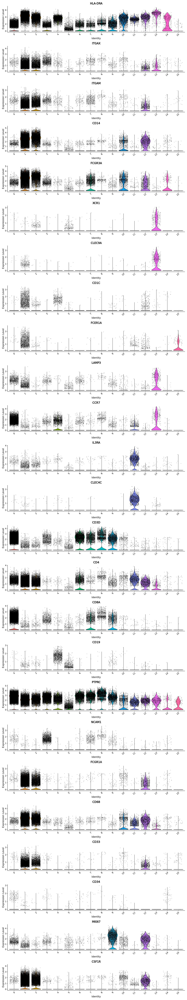

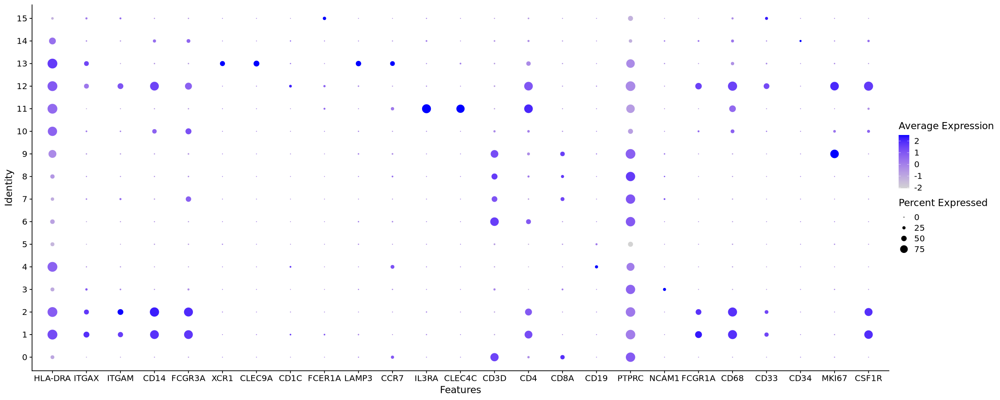

In [32]:
#Same genes over UMAP
options(repr.plot.height=6, repr.plot.width=8)
DimPlot(OC2.45, reduction = "umap", label=TRUE)

options(repr.plot.height=30, repr.plot.width=20)
FeaturePlot(OC2.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"), order = TRUE)

#Violin plots of classic markers
options(repr.plot.height=80, repr.plot.width=15)
VlnPlot(OC2.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"), ncol=1)

#Same as above but dot plot
options(repr.plot.height=8, repr.plot.width=20)
DotPlot(OC2.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"))

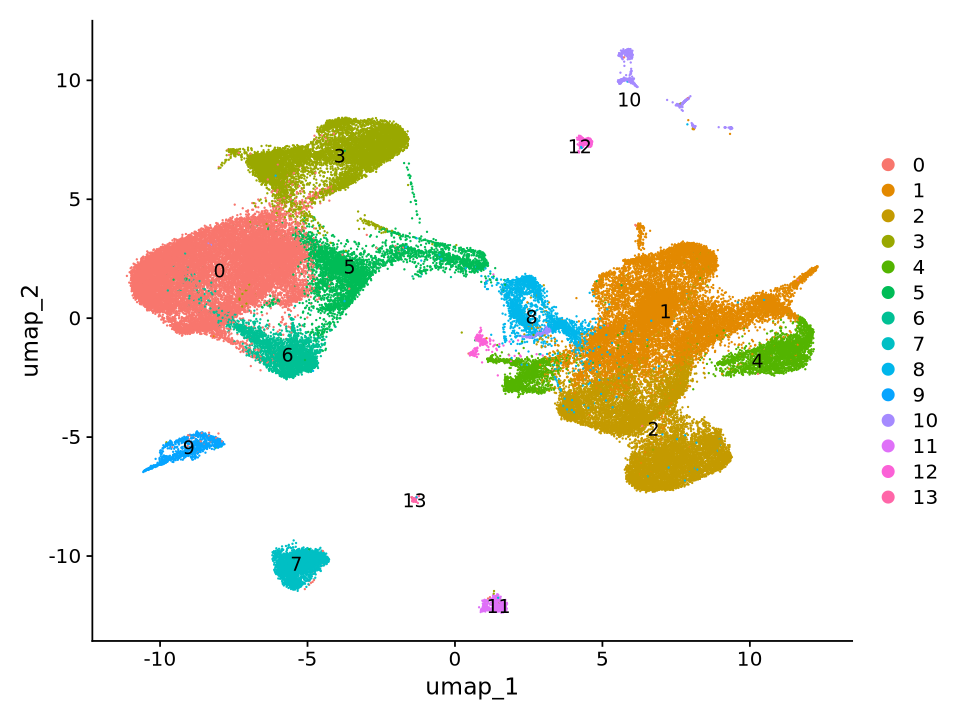

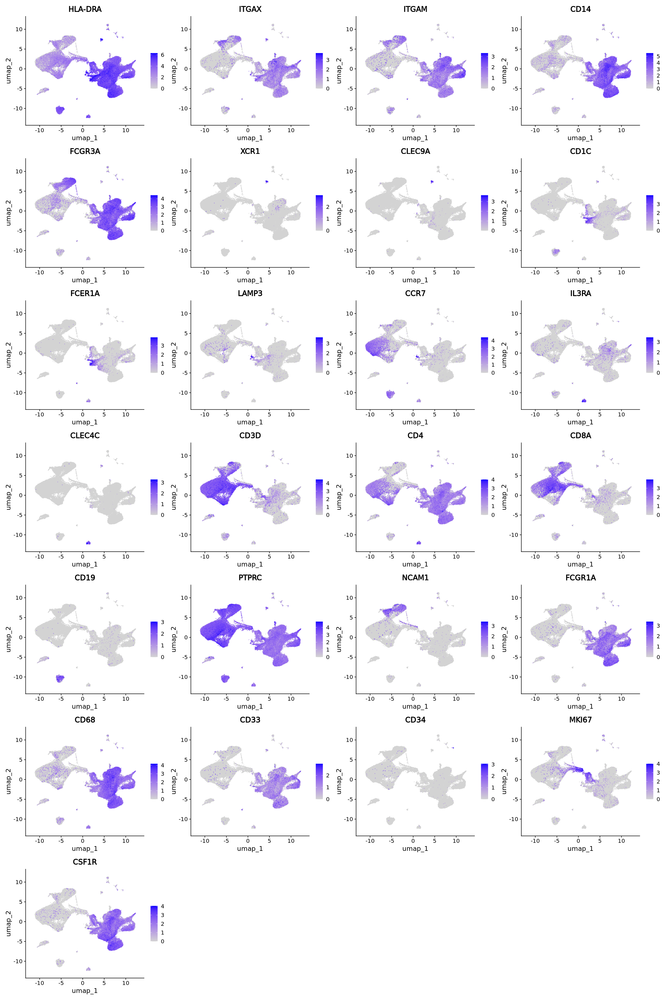

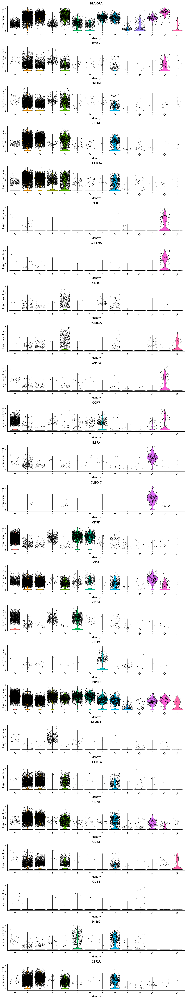

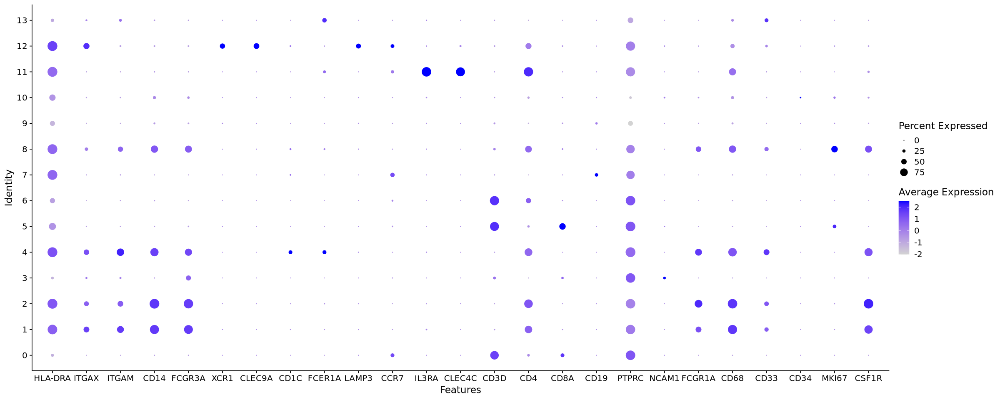

In [33]:
#Same genes over UMAP
options(repr.plot.height=6, repr.plot.width=8)
DimPlot(OC3.45, reduction = "umap", label=TRUE)

options(repr.plot.height=30, repr.plot.width=20)
FeaturePlot(OC3.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"), order = TRUE)

#Violin plots of classic markers
options(repr.plot.height=80, repr.plot.width=15)
VlnPlot(OC3.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"), ncol=1)

#Same as above but dot plot
options(repr.plot.height=8, repr.plot.width=20)
DotPlot(OC3.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"))

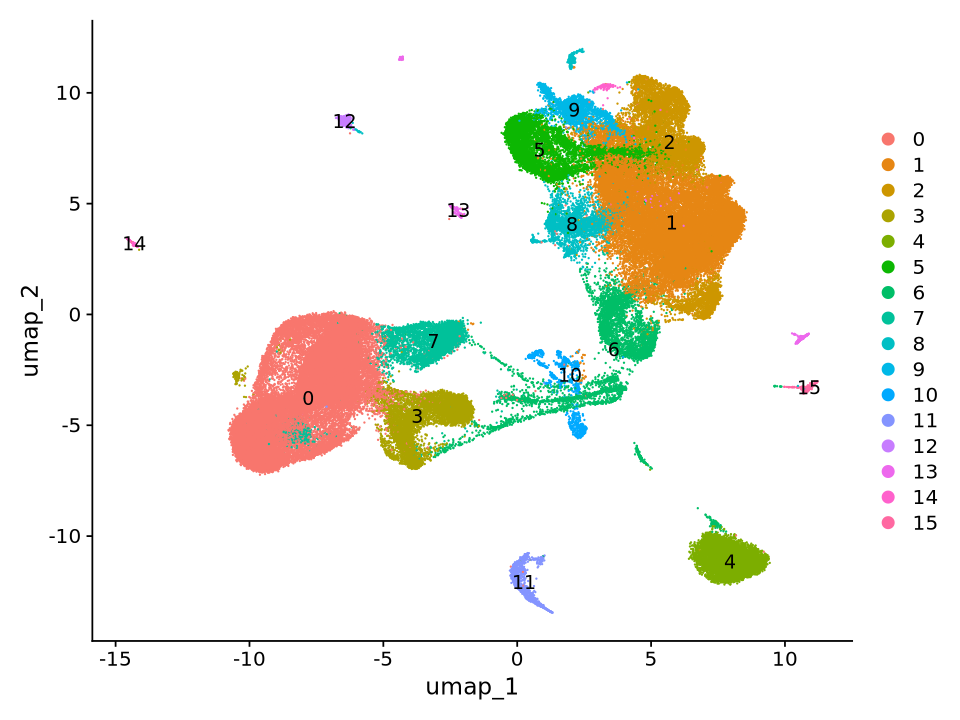

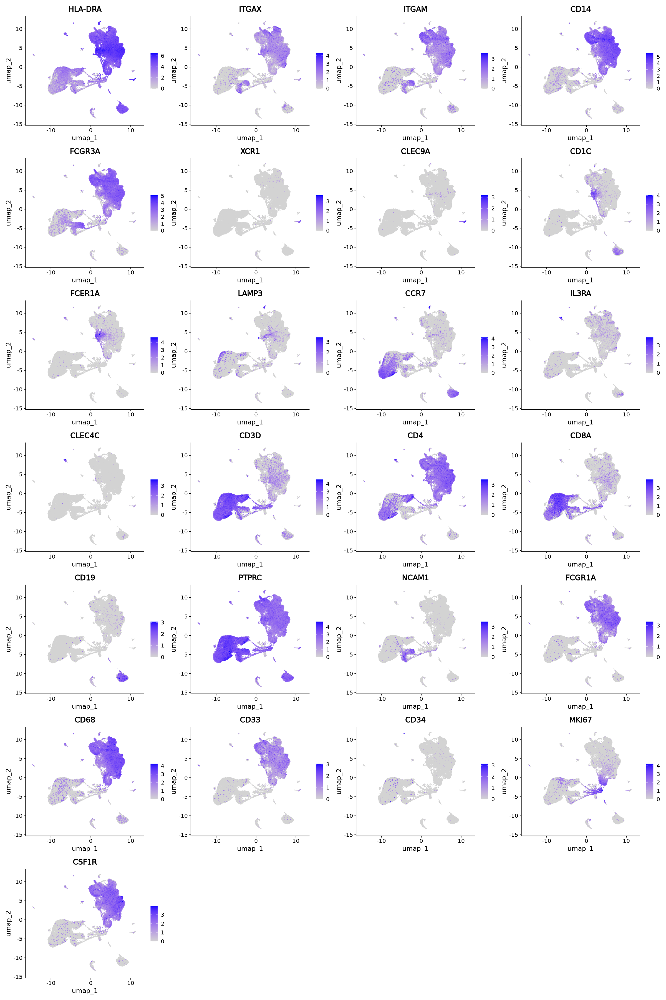

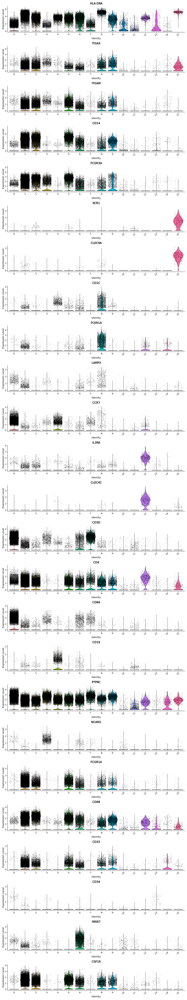

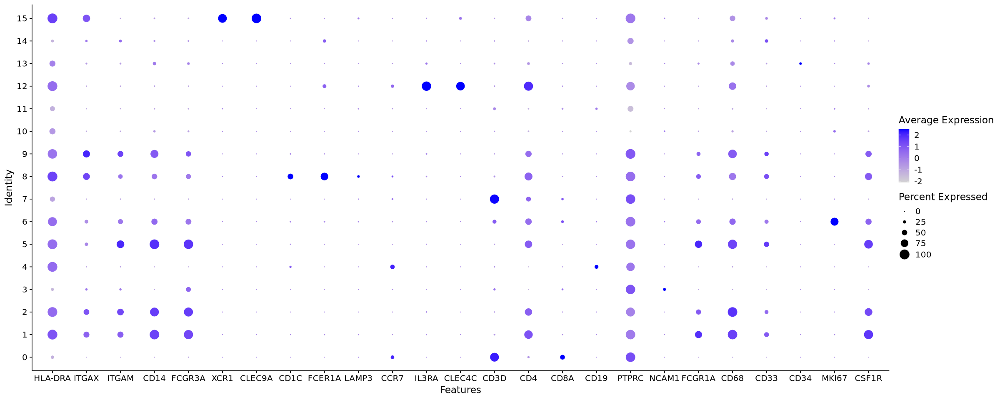

In [34]:
#Same genes over UMAP
options(repr.plot.height=6, repr.plot.width=8)
DimPlot(OC4.45, reduction = "umap", label=TRUE)

options(repr.plot.height=30, repr.plot.width=20)
FeaturePlot(OC4.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"), order = TRUE)

#Violin plots of classic markers
options(repr.plot.height=80, repr.plot.width=15)
VlnPlot(OC4.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"), ncol=1)

#Same as above but dot plot
options(repr.plot.height=8, repr.plot.width=20)
DotPlot(OC4.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"))

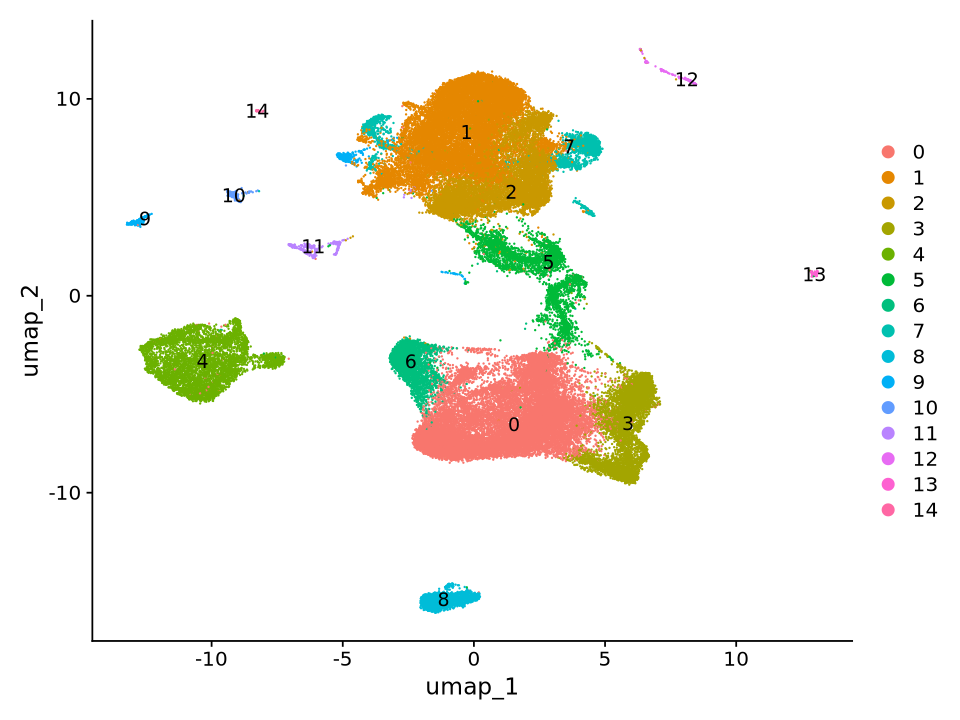

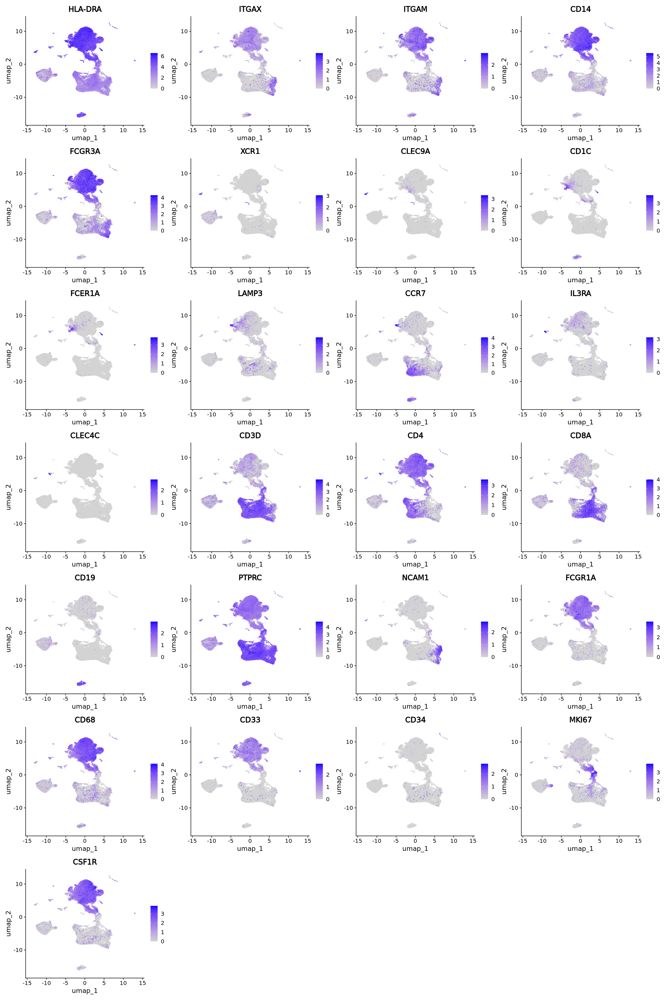

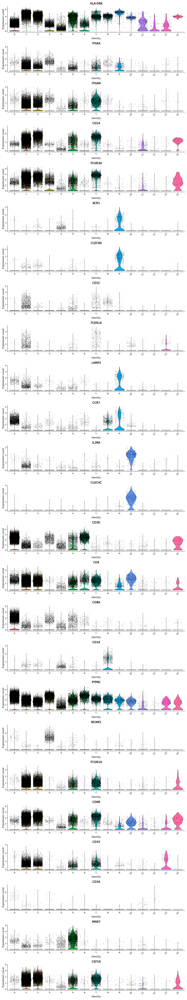

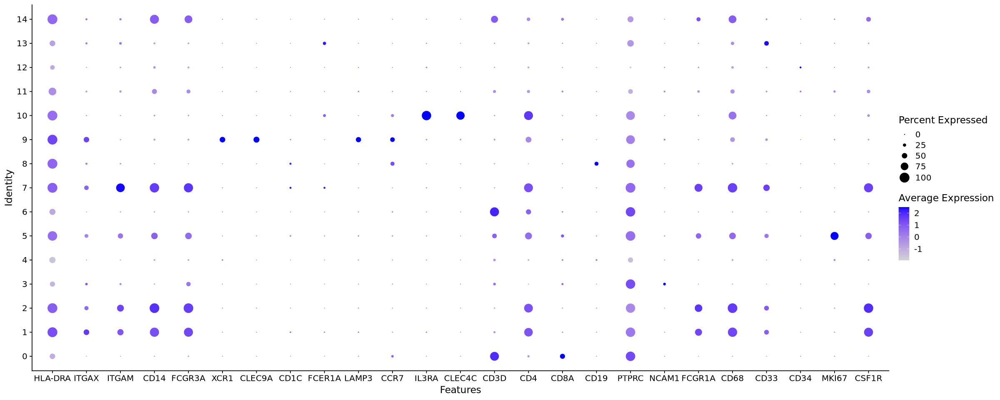

In [35]:
#Same genes over UMAP
options(repr.plot.height=6, repr.plot.width=8)
DimPlot(OC5.45, reduction = "umap", label=TRUE)

options(repr.plot.height=30, repr.plot.width=20)
FeaturePlot(OC5.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"), order = TRUE)

#Violin plots of classic markers
options(repr.plot.height=80, repr.plot.width=15)
VlnPlot(OC5.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"), ncol=1)

#Same as above but dot plot
options(repr.plot.height=8, repr.plot.width=20)
DotPlot(OC5.45, features = c("HLA-DRA", "ITGAX", "ITGAM", "CD14", "FCGR3A", "XCR1", "CLEC9A", "CD1C", "FCER1A", "LAMP3", "CCR7", "IL3RA", "CLEC4C", "CD3D", "CD4", "CD8A", "CD19", "PTPRC", "NCAM1", "FCGR1A", "CD68", "CD33", "CD34", "MKI67", "CSF1R"))

#### Myeloid cluster in each object
* OC1 --> 1,2,5,10,13
* OC2 --> 1,2,10,12,13
* OC3 --> 1,2,4,8,12
* OC4 --> 1,2,5,6,8,9,15
* OC5 --> 1,2,7,9,14

In [36]:
head(OC1.45@meta.data)

,sample,cell_type,percent.mt,nCount_RNA,nFeature_RNA,umap50_1,umap50_2,cluster_label,cluster_label_sub,cell_type_super,⋯,tumor_site,tumor_supersite,sort_parameters,therapy,surgery,sample_type,cancer_type,sample_id,RNA_snn_res.0.2,seurat_clusters
,<chr>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<fct>,<fct>
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCAAGTCTAACC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,6.527574,8196,2692,-8.679758,6.763180,CD8.T.cytotoxic,CD8.T.effector.memory,T.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,0,0
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCACAAACTCGT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.579838,5198,1792,-10.031369,5.792929,CD8.T.ISG,CD4.T.ISG,T.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,0,0
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACCCAGTGAATTGA,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.552810,5018,1727,-9.832402,7.440627,CD4.T.naive,CD4.T.effector.memory,T.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,0,0
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAAAGGACACTG,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,7.002030,6898,2265,-9.703304,4.135003,CD4.T.reg,CD4.T.reg.1,T.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,4,4
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAACATCTCAAG,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,9.461397,4883,1798,-7.801433,6.679767,NA,NA,T.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,0,0
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AAACGAAGTATGAAGT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,T.cell,12.360910,4134,1325,-8.263696,8.116325,NA,NA,T.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,0,0


In [37]:
myeloid_OC1 <- subset(OC1.45, subset = RNA_snn_res.0.2 %in% c("1","2","5","10","13"))
myeloid_OC2 <- subset(OC2.45, subset = RNA_snn_res.0.2 %in% c("1","2","10","12","13"))
myeloid_OC3 <- subset(OC3.45, subset = RNA_snn_res.0.2 %in% c("1","2","4","8","12"))
myeloid_OC4 <- subset(OC4.45, subset = RNA_snn_res.0.2 %in% c("1","2","5","6","8","9","15"))
myeloid_OC5 <- subset(OC5.45, subset = RNA_snn_res.0.2 %in% c("1","2","7","9","14"))

In [38]:
OC1.45
myeloid_OC1

OC2.45
myeloid_OC2

OC3.45
myeloid_OC3

OC4.45
myeloid_OC4

OC5.45
myeloid_OC5

An object of class Seurat 
32223 features across 149760 samples within 1 assay 
Active assay: RNA (32223 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

An object of class Seurat 
32223 features across 54988 samples within 1 assay 
Active assay: RNA (32223 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

An object of class Seurat 
32223 features across 118757 samples within 1 assay 
Active assay: RNA (32223 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

An object of class Seurat 
32223 features across 37655 samples within 1 assay 
Active assay: RNA (32223 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

An object of class Seurat 
32223 features across 73097 samples within 1 assay 
Active assay: RNA (32223 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

An object of class Seurat 
32223 features across 33961 samples within 1 assay 
Active assay: RNA (32223 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

An object of class Seurat 
32223 features across 97206 samples within 1 assay 
Active assay: RNA (32223 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

An object of class Seurat 
32223 features across 47879 samples within 1 assay 
Active assay: RNA (32223 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

An object of class Seurat 
32223 features across 68163 samples within 1 assay 
Active assay: RNA (32223 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

An object of class Seurat 
32223 features across 27740 samples within 1 assay 
Active assay: RNA (32223 features, 2000 variable features)
 3 layers present: counts, data, scale.data
 2 dimensional reductions calculated: pca, umap

In [39]:
#merge myeloid objects together 
OC_myeloid <- merge(myeloid_OC1, y = c(myeloid_OC2, myeloid_OC3, myeloid_OC4, myeloid_OC5), project = "GSE180661")

In [40]:
OC_myeloid

An object of class Seurat 
32223 features across 202223 samples within 1 assay 
Active assay: RNA (32223 features, 0 variable features)
 2 layers present: counts, data

In [41]:
head(OC_myeloid@meta.data)

,sample,cell_type,percent.mt,nCount_RNA,nFeature_RNA,umap50_1,umap50_2,cluster_label,cluster_label_sub,cell_type_super,⋯,tumor_site,tumor_supersite,sort_parameters,therapy,surgery,sample_type,cancer_type,sample_id,RNA_snn_res.0.2,seurat_clusters
,<chr>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AACACACCAAGACCTT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,Myeloid.cell,11.516333,10255,3341,-6.259316,-6.726644,M2.SELENOP,NA,Myeloid.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,1,1
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AACAGGGAGTCCCGGT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,Myeloid.cell,6.619271,14488,4002,-6.357782,-7.509463,Clearing.M,NA,Myeloid.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,1,1
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AACCACAAGACAGCGT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,Myeloid.cell,14.449618,12028,3274,-5.212832,-10.468597,M1.S100A8,NA,Myeloid.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,1,1
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AACCACAAGTCGAATA,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,Myeloid.cell,7.519280,4668,1787,-4.814623,-12.559104,M1.S100A8,NA,Myeloid.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,5,5
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AACCATGTCCTGTTAT,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,Myeloid.cell,3.620654,4861,1329,-5.429079,-8.997123,NA,NA,Myeloid.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,1,1
GSE180661_HGSOC_SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM_AACTTCTCATCCAATG,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,Myeloid.cell,10.215054,8370,2586,-5.818494,-12.637597,M1.S100A8,NA,Myeloid.super,⋯,Omentum,Omentum,"singlet, live, CD45+",pre-Rx,S1,Omentum,HGSOC,SPECTRUM-OV-002_S1_CD45P_INFRACOLIC_OMENTUM,5,5


In [42]:
saveRDS(OC_myeloid, "/scratch/user/s4436039/scdata/GSE180661/GSE180661_myeloid.RDS")

#### Following the above then need to move entire GSE180661 folder from scratch to rdm
``` bash
rsync -azvhp /scratch/user/s4436039/scdata/GSE180661/ /QRISdata/Q5935/nikita/scdata/GSE180661
```